Extragalactic sources are of primaty interest in the LH catalogue. Purpose of this notebook is to separate X-ray stars (mainly galactic objects) from extragalactic sources.

In [1]:
import warnings
warnings.filterwarnings(action='ignore')

import pandas as pd
import numpy as np

# import matplotlib
# matplotlib.use('macosx')
import matplotlib.pyplot as plt
plt.style.use('seaborn')

import seaborn as sns

from astropy.table import Table
plt.style.use('seaborn-paper')
sns.set_context('notebook', font_scale=1.7)
sns.set_style('whitegrid', rc={'ytick.left':True, 'ytick.direction':'in',
                               'xtick.bottom':True, 'xtick.direction':'in',
                               'ytick.minor.visible':True})
plt.rc('font', family='serif', variant='small-caps')
# Для Jupyter
%config InlineBackend.figure_formatb = 'retina'
# %config InlineBackend.print_figure_kwargs.update({'quality' : 100})
%matplotlib inline
plt.rcParams['savefig.dpi'] = 300
plt.rcParams['figure.dpi'] = 300
# plt.rcParams['figure.figsize'] = (10, 7)

from astropy.table import Table
# import healpy as hp

from astropy.coordinates import SkyCoord
from astropy import units as u

import lh_functions as lhf
from csc_xmm import def_csc_xmm as dcx

# from matplotlib.ticker import FormatStrFormatter
import healpy as hp

# %matplotlib inline

# Подготовка данных (Gaia)

DET_LIKE_0 > 6
EXT_LIKE < 6

Before X-ray source filters: 9500
After X-ray source filters: 9228

pos_r98 correction (pos_r98_corr)
- - - - - 
Coefficient: 1.1
Lower threshold: 5

Weak ERO sources in X-ray duplicates removed (temporary measure)



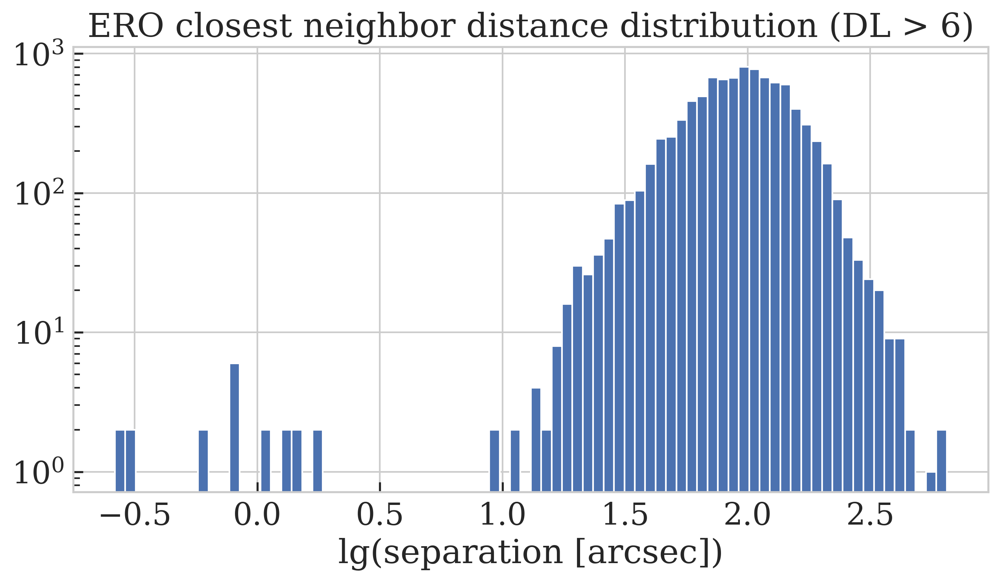

In [2]:
lh_df = pd.read_pickle('data/LH_catalogs_13_05/lhpv_03_23_sd01_a15_g14.pkl')
lh_DL_6_df = lhf.xray_filtration(lh_df, DL_thresh=6, EL_thresh=6)

c = SkyCoord(ra=lh_DL_6_df['RA_fin']*u.degree, dec=lh_DL_6_df['DEC_fin']*u.degree)
catalog = SkyCoord(ra=lh_DL_6_df['RA_fin']*u.degree, dec=lh_DL_6_df['DEC_fin']*u.degree)
idx, ero2ero, _ = c.match_to_catalog_sky(catalog, nthneighbor=2)

plt.figure(figsize=(10, 5))

plt.hist(np.log10(ero2ero.arcsec), bins=80)
plt.yscale('log')
plt.xlabel('lg(separation [arcsec])')
plt.title('ERO closest neighbor distance distribution (DL > 6)')
plt.show()

In [3]:
# lh_DL_6_df[['srcname_fin', 'RA_fin', 'DEC_fin', 'DET_LIKE_0']][ero2ero.arcsec < 10 ** .5].sort_values(by='RA_fin').reset_index(drop=True)

In [4]:
# lh_df.to_csv('data/lhpv_03_23_sd01_a15_g14.csv')

DL_min = 10
EL_max = 6

# Фильтрация рентгеновских источников
lh_filtered_df = lhf.xray_filtration(lh_df, DL_thresh=DL_min, EL_thresh=EL_max)

stat_str = 'После фильтрации по протяженности и правдоподобию детектирования потеряно:'
print(f'{stat_str}')
print(f'{lh_df.shape[0] - lh_filtered_df.shape[0]} ({1 - lh_filtered_df.shape[0] / lh_df.shape[0]:.1%})')

DET_LIKE_0 > 10
EXT_LIKE < 6

Before X-ray source filters: 9500
After X-ray source filters: 6893

pos_r98 correction (pos_r98_corr)
- - - - - 
Coefficient: 1.1
Lower threshold: 5

Weak ERO sources in X-ray duplicates removed (temporary measure)

После фильтрации по протяженности и правдоподобию детектирования потеряно:
2609 (27.5%)


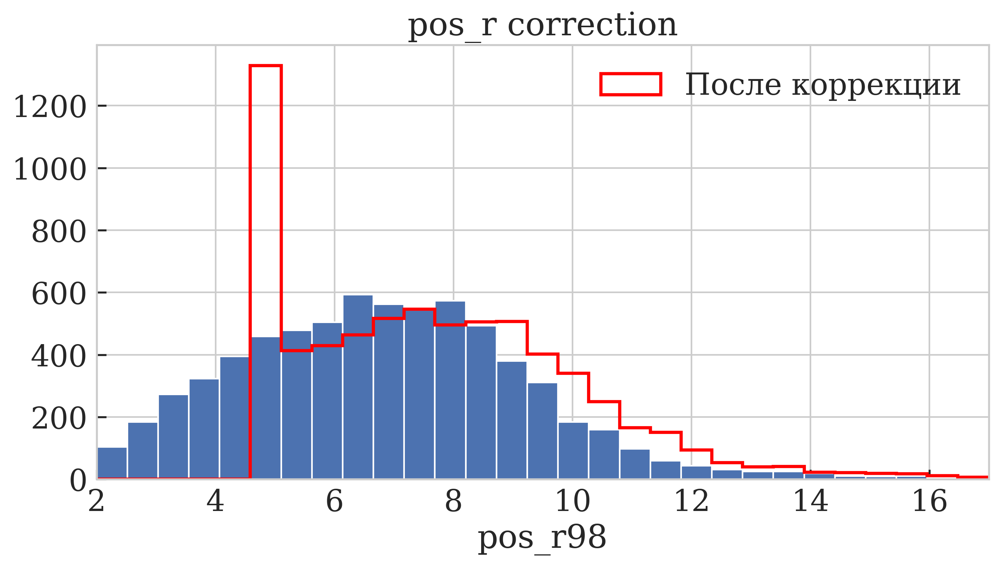

In [5]:
plt.figure(figsize=(10, 5))

plt.title('pos_r correction')

xlims = [2, 17]

r98_linspace = np.linspace(*xlims, 30)

lh_filtered_df['pos_r98'].hist(bins=r98_linspace)
lh_filtered_df['pos_r98_corr'].hist(bins=r98_linspace, histtype='step', lw=2,
                                    color='red', label='После коррекции')

plt.xlabel('pos_r98')
plt.legend()

plt.xlim(*xlims)

plt.show()

In [6]:
lh_filtered_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6891 entries, 0 to 9467
Data columns (total 68 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   srcname_fin    6891 non-null   object 
 1   RA_fin         6891 non-null   float64
 2   DEC_fin        6891 non-null   float64
 3   GLON           6891 non-null   float64
 4   GLAT           6891 non-null   float64
 5   pos_r98        6891 non-null   float32
 6   DET_LIKE_0     6891 non-null   float32
 7   ML_FLUX_0      6891 non-null   float32
 8   ML_FLUX_ERR_0  6861 non-null   float32
 9   ML_CTS_0       6891 non-null   float32
 10  ML_CTS_ERR_0   6861 non-null   float32
 11  ML_EXP_1       6891 non-null   float32
 12  EXT            6891 non-null   float32
 13  EXT_LIKE       6891 non-null   float32
 14  EXT_ERR        6891 non-null   float32
 15  ID_SRC         6891 non-null   int32  
 16  ID_CLUSTER     6891 non-null   int32  
 17  RA             6891 non-null   float64
 18  DEC     

In [7]:
# lh_filtered_df.to_csv('/Users/mike/Repos/WWT/data/lh_filtered_r98_corr.csv')

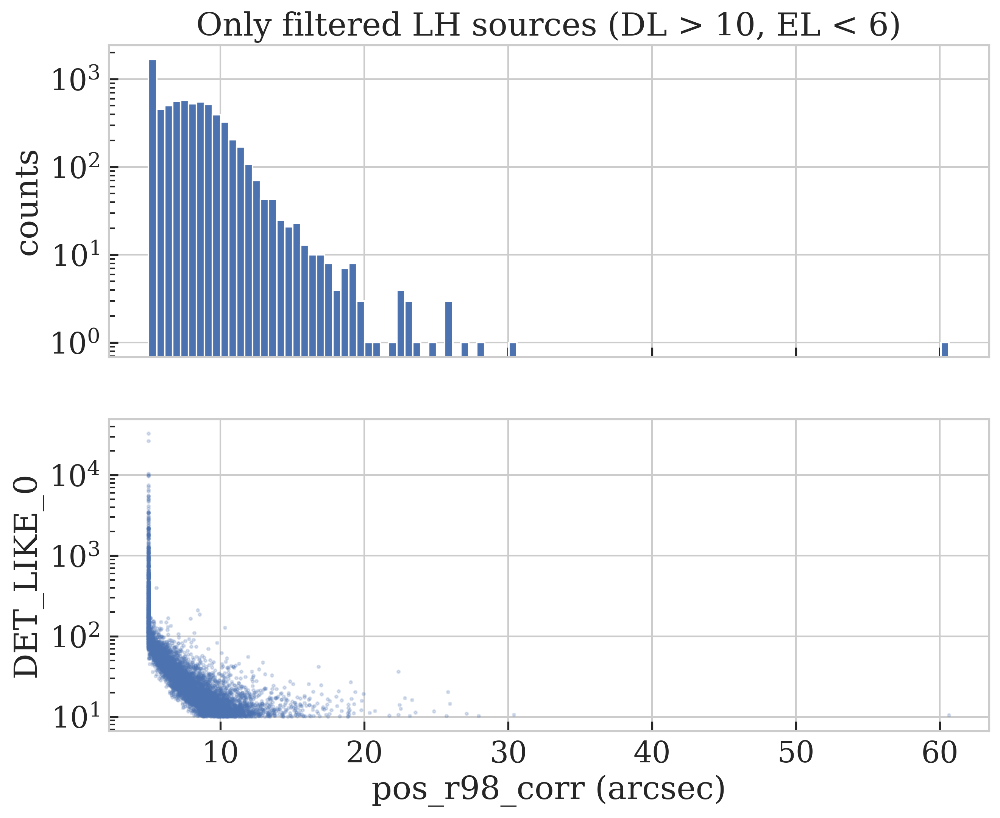

In [8]:
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(10, 8), sharex=True)

# ax1.figure(figsize=(10, 5))

lh_filtered_df['pos_r98_corr'].hist(bins=100, ax=ax1)

ax1.set_yscale('log')
ax1.set_ylabel('counts')

ax1.set_title(f'Only filtered LH sources (DL > {DL_min}, EL < {EL_max})')

ax2.scatter(lh_filtered_df['pos_r98_corr'], lh_filtered_df['DET_LIKE_0'], s=3, alpha=0.2)

ax2.set_yscale('log')
ax2.set_xlabel('pos_r98_corr (arcsec)')
ax2.set_ylabel('DET_LIKE_0')
# ax2.set_xlim(0, 30)

plt.show()

* 16 источников ERO имеют r_98 > 20"

In [9]:
# Координаты источников ERO для корреляции с оптическими обзорами
# lh_radec_fits = lh_df[['srcname_fin', 'RA_fin', 'DEC_fin']]
# Table.from_pandas(lh_radec_fits).write('data/correlations/lh_radec_fin.fits', format='fits')

# Источники GAIA eDR3 в 60 секундах от источников ERO
# lh_gaia_60_df = Table.read('data/correlations/lh_radec_fin_gaia_60sec_edr3.fits').to_pandas()
# lh_gaia_60_df['srcname_fin'] = lh_gaia_60_df['srcname_fin'].astype(str).str[2:-1]
lh_gaia_60_df = pd.read_csv('data/correlations/lh_radec_fin_gaia_60sec_dr3_aph.csv')

columns_to_drop = ['col1', 'ID_CLUSTER', 'RADEC_ERR', 'DIST_NN', 'SRCDENS',
                   'TSTART', 'TSTOP', 'EXT_LOWERR', 'EXT_UPERR', 'ML_RATE_0',
                   'ML_RATE_ERR_0', 'ML_BKG_0', 'RA_corr', 'DEC_corr', 'g_id',
                   'g_d2d', 'g_nsrc', 'g_s', 'g_gmag', 'RA_1', 'DEC_1',
                   'g_maxLx', 'g_b', 's_id', 's_z', 's_otype', 's_d2d', 's_nsrc',
                   'flag_xray', 'flag_radio', 'flag_agn_wise', 'w1', 'w2', 'w3', 'w1snr',
                   'w2snr', 'w3snr', 'w_nsrc', 'sdss_nsrc', 'sdss_p', 'sdss_id',
                   'sdss_sp', 'sdss_d2d', 'hpidx']

lh_gaia_60_df = lh_gaia_60_df.drop(columns=columns_to_drop)
lh_gaia_60_df = lh_gaia_60_df.rename(columns={'ra_2': 'ra', 'dec_2': 'dec'})

In [10]:
# # Добавляю рентгеновские признаки
# lh_slim_df = lh_df[['srcname_fin', 'pos_r98', 'DET_LIKE_0', 'EXT_LIKE', 'flux_05-20']]
# lh_gaia_60_df = lh_slim_df.merge(lh_gaia_60_df, on='srcname_fin', how='right')


# Оставляю только надежные рентгеновские источники
lh_gaia_60_df = lhf.xray_filtration(lh_gaia_60_df, DL_thresh=DL_min, EL_thresh=EL_max,
                                    verbouse=False)

pos_r98 correction (pos_r98_corr)
- - - - - 
Coefficient: 1.1
Lower threshold: 5

Weak ERO sources in X-ray duplicates removed (temporary measure)



### Корректировка на собственное движение

```python
ra_propagated = ra  + pmra / 3600e3  * (epoch - edr3_epoch) / cos(rad(dec))
dec_propagated = dec + pmdec / 3600e3 * (epoch - edr3_epoch)
```

Gaia epoch: 2016
Target epoch: 2019.8


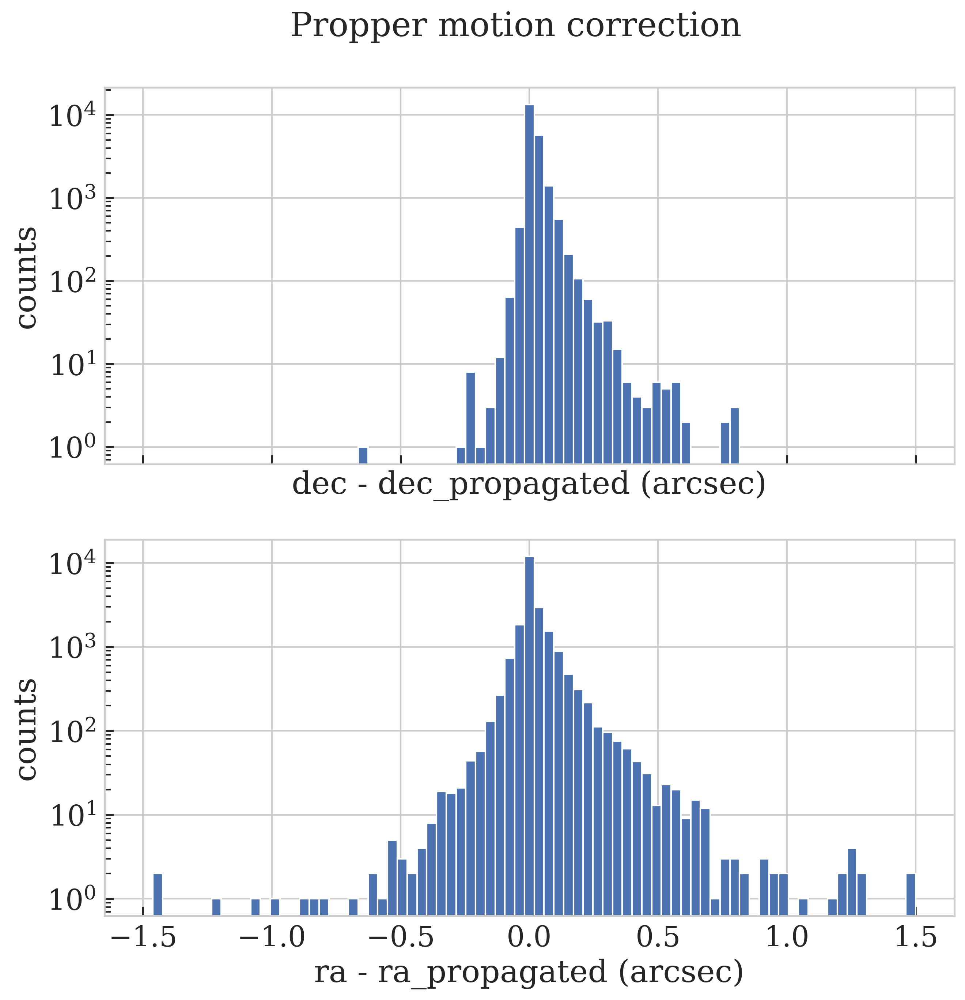

In [11]:
# Наблюдения в LH происходили в октябре 2019 года
lh_gaia_60_df = lhf.gaia_coord_correction(lh_gaia_60_df, 2019.8, s_n_threshold=4)

fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(10, 10), sharex=True)

diff_space = np.linspace(-1.5, 1.5, 80)

ax1.hist(3600 * (lh_gaia_60_df['dec'] - lh_gaia_60_df['dec_prop']), bins=diff_space)
ax1.set_yscale('log')
ax1.set_xlabel('dec - dec_propagated (arcsec)')
ax1.set_ylabel('counts')

ax2.hist(3600 * (lh_gaia_60_df['ra'] - lh_gaia_60_df['ra_prop']), bins=diff_space)
ax2.set_yscale('log')
ax2.set_xlabel('ra - ra_propagated (arcsec)')
ax2.set_ylabel('counts')

fig.suptitle('Propper motion correction', fontsize=22, y=.95)

plt.show()

* В подавляющем большинстве случаев (95%) в r_98 находится единственный кандидат Gaia

In [12]:
# # Пробую оценить ожидаемое количество источников поля
# gaia_poisson_df = (lh_gaia_60_df[['srcname_fin', 'pos_r98_corr']]
#                                 .drop_duplicates()
#                                 .reset_index(drop=True))

# gaia_poisson_df['area98'] = np.pi * gaia_poisson_df['pos_r98_corr'] ** 2

# # Field sources density
# R1 = 30
# R2 = 60

# ring_area = np.pi * (R2 ** 2 - R1 ** 2)
# print(f'Ring area ({R1}" - {R2}"): {ring_area:.0f} sq. sec.')

# lh_gaia_30_60_df = lh_gaia_60_df[(lh_gaia_60_df['sep_prop'] > R1)
#                                 &(lh_gaia_60_df['sep_prop'] < R2)]
             
# gaia_field_stat_df = pd.DataFrame(lh_gaia_30_60_df.groupby('srcname_fin').size())
# gaia_field_stat_df.columns = ['n_objects']

# gaia_field_stat_df['field_density'] = gaia_field_stat_df['n_objects'] / ring_area
# gaia_median_density = gaia_field_stat_df['field_density'].mean()

# gaia_poisson_df['n_estimated_field'] = gaia_poisson_df['area98'] * gaia_median_density

# gaia_poisson_df['n_simulated'] = np.random.poisson(gaia_poisson_df['n_estimated_field'])

# gaia_poisson_df['n_simulated'].value_counts()

### Количество объектов Gaia в $r_{98}$:

`Задача`: cравнить наблюдаемое и ожидаемое количество кружков $r_{98}$, содержащих $n = 1,\ 2 ...,\ N$ объектов Gaia.

Пусть объекты Gaia распределены равномерно в LH, тогда вероятность обнаружить $n$ объектов Gaia в кружке $r_{98}$:

$$
p(n) = \frac{\lambda ^{n}e^{-\lambda}}{n!}
$$ {#eq-poisson}

Где $\lambda$ --- среднее количество объектов Gaia в кружке $r_{98}$ (площадь кружка $\times$ средняя плотность объектов Gaia в LH).

In [13]:
lh_gaia_dr3_r98_df = lh_gaia_60_df[lh_gaia_60_df['sep_prop'] < lh_gaia_60_df['pos_r98_corr']]

observe_stat_df = lh_gaia_dr3_r98_df.groupby('srcname_fin').size().value_counts()
observe_stat_df.loc[0] = (lh_gaia_60_df['srcname_fin'].nunique()
                          - lh_gaia_dr3_r98_df['srcname_fin'].nunique())
observe_stat_df = observe_stat_df.sort_index()

print_observe_stat_df = pd.DataFrame(observe_stat_df).T
print_observe_stat_df.index = ['DR3']

# print_observe_stat_df.loc['eDR3'] = [4426, 2022, 120, 5, 3]

print_observe_stat_df

,0,1,2,3,4,6
DR3,3819,2575,167,8,4,2


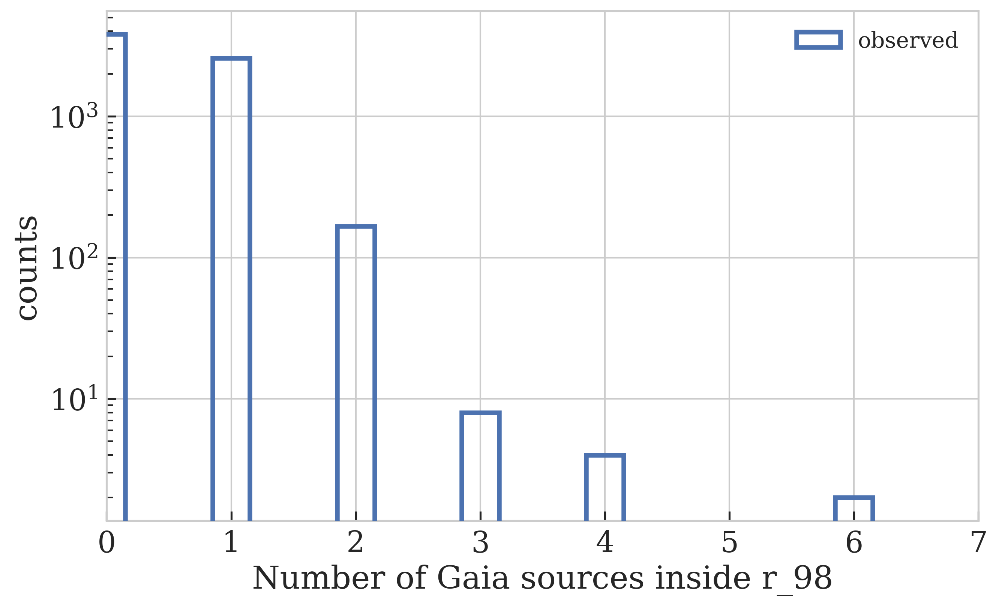

In [14]:
fig, ax = plt.subplots(figsize=(10, 6), sharex=True)

ax.bar(observe_stat_df.index, observe_stat_df, edgecolor='C0', color='none',
       lw=3, zorder=3, label='observed', width=.3)

ax.set_ylabel('counts')
ax.set_xlim(0, 7)

ax.tick_params(axis='x', labelrotation=0)

ax.set_yscale('log')
# fig.savefig('images/EDA_plots/ero_gaia_nsources_in_search_r.png', bbox_inches='tight')

ax.set_xlabel('Number of Gaia sources inside r_98')
# labels = [item.get_text() for item in ax.get_xticklabels()]
# print(labels)

# ax.set_xticks([0, 1, 2, 3], [1, 2, 3, 4])

ax.legend(fontsize=14)

plt.show()

In [15]:
observed_counts_r98 = lh_gaia_dr3_r98_df.groupby('srcname_fin').size()
observed_counts_60 = lh_gaia_60_df.groupby('srcname_fin').size()

density = observed_counts_60.mean() / (np.pi * 60 ** 2)
print(f'Density: {density:.4f} arcsec^-2 (~{density * 3600:.1f} arcmin^-2)')
print()

Density: 0.0003 arcsec^-2 (~1.1 arcmin^-2)



In [16]:
gaia_3_r98_df = lhf.poisson_k(k=3, density=density, r98_df=lh_gaia_dr3_r98_df)

gaia_3_r98_df

** k = 3 **


,srcname_fin,pos_r98_corr,probability (%)
0,SRGe J110749.6+583509,30,4.487408
1,SRGe J104858.8+603236,26,2.097163
2,SRGe J103622.9+604036,15,0.119229
3,SRGe J110642.4+591918,12,0.037719
4,SRGe J103411.7+562614,9,0.007599
5,SRGe J103357.6+580813,8,0.003510
6,SRGe J104526.4+560201,8,0.003827
7,SRGe J102843.3+564224,5,0.000327


In [17]:
gaia_4_r98_df = lhf.poisson_k(k=4, density=density, r98_df=lh_gaia_dr3_r98_df)

gaia_4_r98_df

** k = 4 **


,srcname_fin,pos_r98_corr,probability (%)
0,SRGe J110339.5+593706,17,0.016730
1,SRGe J105058.0+545611,14,0.003740
2,SRGe J105211.8+582623,8,0.000031
3,SRGe J105528.3+575423,8,0.000043


In [18]:
gaia_6_r98_df = lhf.poisson_k(k=6, density=density, r98_df=lh_gaia_dr3_r98_df)

gaia_6_r98_df

** k = 6 **


,srcname_fin,pos_r98_corr,probability (%)
0,SRGe J104541.2+601244,61,7.285463e+00
1,SRGe J104522.1+555738,6,1.690025e-10


::: {.panel-tabset}

## Table 1

In [19]:
gaia_features = ['source_id', 'ra_prop', 'dec_prop', 'sep_prop',
                 'srcname_fin', 'pos_r98_corr', 'DET_LIKE_0', 'RA_fin', 'DEC_fin']

lh_gaia_dr3_r98_df[lh_gaia_dr3_r98_df['srcname_fin'] == gaia_3_r98_df['srcname_fin'].iloc[0]][gaia_features].reset_index(drop=True)

,source_id,ra_prop,dec_prop,sep_prop,srcname_fin,pos_r98_corr,DET_LIKE_0,RA_fin,DEC_fin
0,857352648549979008,166.960793,58.586232,7.657533,SRGe J110749.6+583509,30.391128,10.642184,166.956762,58.585899
1,857352648550047616,166.951345,58.582715,15.319617,SRGe J110749.6+583509,30.391128,10.642184,166.956762,58.585899
2,857352854708866560,166.958089,58.594002,29.276721,SRGe J110749.6+583509,30.391128,10.642184,166.956762,58.585899


## Table 2

In [20]:
gaia_features_2 = ['srcname_fin', 'DET_LIKE_0', 'pos_r98_corr', 'RA_fin', 'DEC_fin',
                   'source_id', 'ra_prop', 'dec_prop', 'sep_prop']
                   
lh_gaia_dr3_r98_df[lh_gaia_dr3_r98_df['srcname_fin'] == gaia_4_r98_df['srcname_fin'].iloc[0]][gaia_features_2].reset_index(drop=True)

,srcname_fin,DET_LIKE_0,pos_r98_corr,RA_fin,DEC_fin,source_id,ra_prop,dec_prop,sep_prop
0,SRGe J110339.5+593706,24.702732,17.003737,165.914542,59.618312,860664442000641152,165.909650,59.614990,14.910704
1,SRGe J110339.5+593706,24.702732,17.003737,165.914542,59.618312,860664446292526976,165.913857,59.618122,1.422257
2,SRGe J110339.5+593706,24.702732,17.003737,165.914542,59.618312,860664446292879232,165.908180,59.619989,13.063423
3,SRGe J110339.5+593706,24.702732,17.003737,165.914542,59.618312,860664446292918400,165.912541,59.622629,15.962709


## Table 3

In [21]:
lh_gaia_dr3_r98_df[lh_gaia_dr3_r98_df['srcname_fin'] == gaia_6_r98_df['srcname_fin'].iloc[1]][gaia_features_2].reset_index(drop=True)

,srcname_fin,DET_LIKE_0,pos_r98_corr,RA_fin,DEC_fin,source_id,ra_prop,dec_prop,sep_prop
0,SRGe J104522.1+555738,68.29301,5.939569,161.341945,55.96063,850985338063534720,161.343266,55.960381,2.807485
1,SRGe J104522.1+555738,68.29301,5.939569,161.341945,55.96063,850985342352984960,161.344123,55.960798,4.428901
2,SRGe J104522.1+555738,68.29301,5.939569,161.341945,55.96063,850985342352985600,161.342155,55.961908,4.619051
3,SRGe J104522.1+555738,68.29301,5.939569,161.341945,55.96063,850985342352987136,161.341221,55.960665,1.464983
4,SRGe J104522.1+555738,68.29301,5.939569,161.341945,55.96063,850985342352987648,161.344112,55.961206,4.834294
5,SRGe J104522.1+555738,68.29301,5.939569,161.341945,55.96063,850985342354361088,161.341837,55.961133,1.824813


:::

::: {.panel-tabset}

## Fig 1

Pixel area: 0.003 arcdeg^2
(11.8 arcmin^2)


20.11899432592691 44.881005674073094 137.95697990146084 184.0430200985392


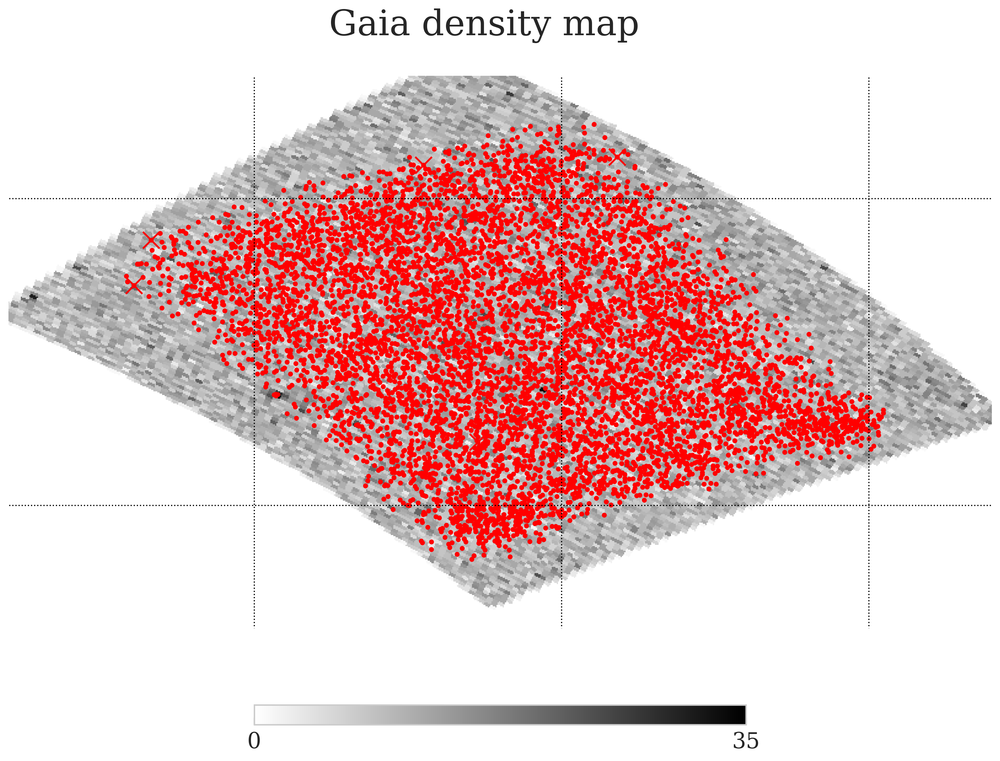

In [22]:
gaia_df = pd.read_csv('data/gaia/gaia_dr3_astroph_4-result.csv')
# gaia_df = pd.read_csv('data/lh_radec_fin_gaia_60sec_edr3.fits')

suspicious_gaia_df = (lh_filtered_df[lh_filtered_df['srcname_fin']
                    .isin(gaia_3_r98_df['srcname_fin'])][['RA_fin', 'DEC_fin']])

fig, ax = plt.subplots(figsize=(15, 15))

NSIDE_1 = 2 ** 10

area_arcdeg = hp.nside2pixarea(NSIDE_1, degrees=True)
area_arcmin = hp.nside2pixarea(NSIDE_1, degrees=True) * 3600

print(f'Pixel area: {area_arcdeg:.1} arcdeg^2')
print(f'({area_arcmin:.4} arcmin^2)')

map_2, gaia_counts = lhf.cat2hpx(gaia_df['ra'].values, gaia_df['dec'].values, nside=NSIDE_1)

hp_map = hp.cartview(map_2, cmap='binary', return_projected_map=True,
                     hold=True, cbar=True, title=' ',
                     lonra=[153, 169], latra=[53, 62])

hp.visufunc.projscatter(suspicious_gaia_df['RA_fin'], suspicious_gaia_df['DEC_fin'], lonlat=True,
                        s=200, zorder=2, color='red', marker='x', alpha=1)

hp.visufunc.projscatter(lh_filtered_df['RA_fin'], lh_filtered_df['DEC_fin'], lonlat=True,
                        s=10, zorder=2, color='red', alpha=1)

hp.graticule(dmer=5, dpar=5, coord='E')

fig.suptitle('Gaia density map', y=.75, fontsize=30)

# fig.savefig('images/EDA_plots/suspicious_gaia.png', bbox_inches='tight')

plt.show()

## Fig 2

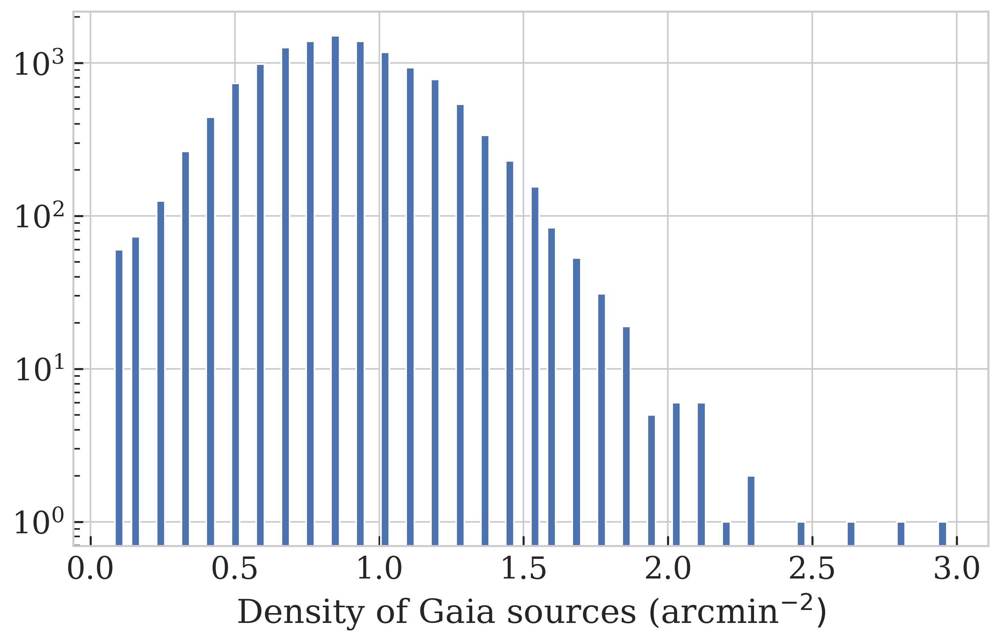

In [23]:
fig, ax = plt.subplots(figsize=(10, 6))

ax.hist(gaia_counts / area_arcmin, bins=100)

ax.set_yscale('log')

ax.set_xlabel(r'Density of Gaia sources (arcmin$^{-2})$')

# fig.savefig('images/EDA_plots/gaia_density.png', bbox_inches='tight')

plt.show()

:::

Extracting stars from Gaia catalogue...

S/N threshold: 4 (for parallax & propper motion)

Before stars extraction: 129743
After stars extraction: 60885 (47%)



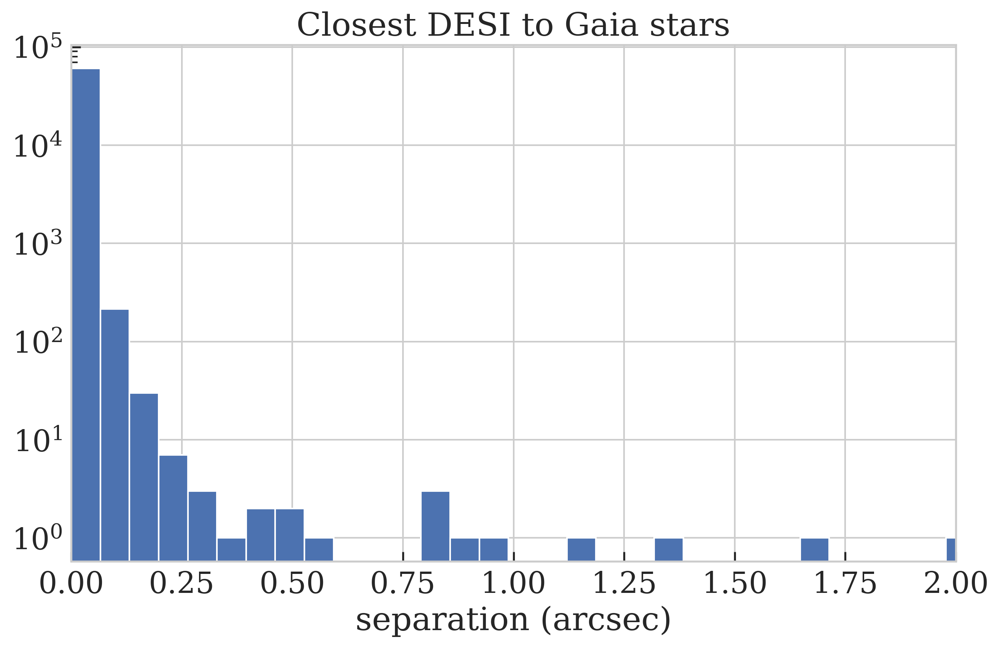

In [24]:
# Separations between Gaia stars and closest DESI sources

gaia_stars_df = lhf.star_extraction(gaia_df, s_n_threshold=4, optic_cat='gaia')

desi_df = pd.read_pickle('data/desi/desi_lh.gz_pkl', compression='gzip')

desi_df['desi_id'] = desi_df['release'].astype(str) + '_' + \
                     desi_df['brickid'].astype(str) + '_' + \
                     desi_df['objid'].astype(str)

gaia_stars_coords = SkyCoord(ra=gaia_stars_df['ra']*u.degree, dec=gaia_stars_df['dec']*u.degree)
desi_coords = SkyCoord(ra=desi_df['ra'].values*u.degree, dec=desi_df['dec'].values*u.degree)

_, all_gaia2desi, _ = gaia_stars_coords.match_to_catalog_sky(desi_coords, nthneighbor=1)

plt.figure(figsize=(10, 6))

plt.hist(all_gaia2desi.arcsec, bins=100)
plt.yscale('log')
plt.xlabel('separation (arcsec)')

plt.title('Closest DESI to Gaia stars')

plt.xlim(0, 2)

plt.show()

In [25]:
desi_df = lhf.reliable_magnitudes(desi_df, s_n_threshold=4, xray=False)

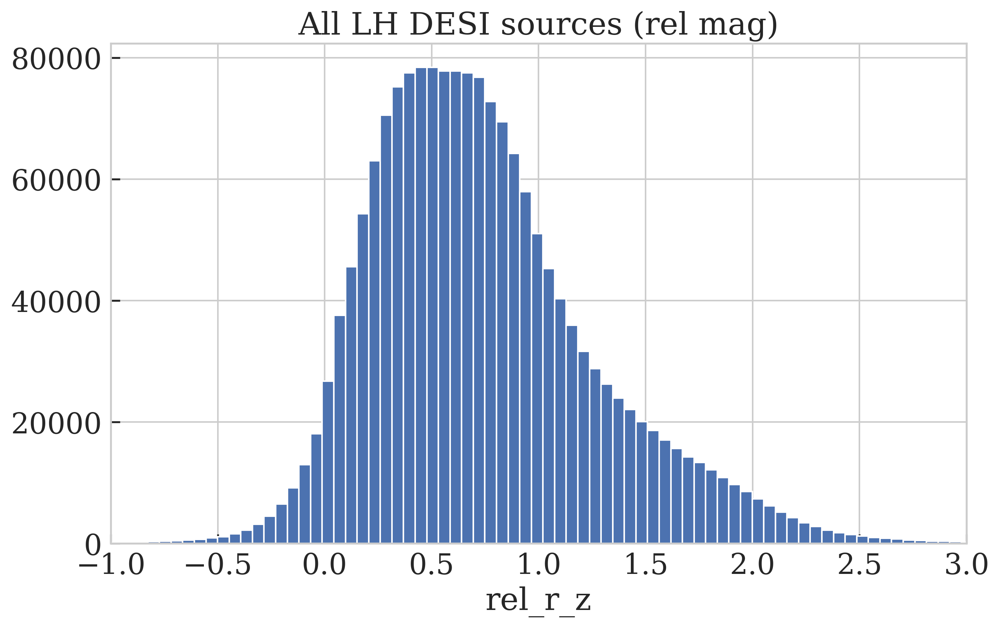

In [26]:
fig, ax = plt.subplots(figsize=(10, 6))

desi_df['rel_dered_r_z'].hist(bins=300)

ax.set_title('All LH DESI sources (rel mag)')
ax.set_xlabel('rel_r_z')

ax.set_xlim(-1, 3)

plt.show()

__В исходном каталоге присутствуют дубликаты по рентгеновскму индексу:__

In [27]:
duplicated_ero_df = (lh_df[lh_df.duplicated(subset=['srcname_fin'], keep=False)]
                     .sort_values(by='srcname_fin').iloc[:, :14])

print(list(duplicated_ero_df['srcname_fin'].unique()))

duplicated_ero_df

['SRGe J104659.3+573056', 'SRGe J104700.7+574558', 'SRGe J105036.4+575539']


,srcname_fin,RA_fin,DEC_fin,GLON,GLAT,pos_r98,DET_LIKE_0,ML_FLUX_0,ML_FLUX_ERR_0,ML_CTS_0,ML_CTS_ERR_0,ML_EXP_1,EXT,EXT_LIKE
135,SRGe J104659.3+573056,161.747275,57.515467,150.085188,52.548785,2.454042,1232.995361,1.105359e-13,5.250384e-15,518.103088,24.609554,4282.133301,0.0,0.0
1144,SRGe J104659.3+573056,161.747098,57.515488,150.085265,52.548700,8.743238,15.079515,2.644247e-14,5.075612e-15,123.940002,23.790190,4282.101562,0.0,0.0
153,SRGe J104700.7+574558,161.753109,57.766085,149.771311,52.386750,2.565521,1056.781372,1.028144e-13,5.085833e-15,485.921875,24.036686,4317.775391,0.0,0.0
1311,SRGe J104700.7+574558,161.752869,57.766125,149.771399,52.386628,7.043487,13.630091,2.389760e-14,4.797188e-15,112.944969,22.672497,4317.775391,0.0,0.0
246,SRGe J105036.4+575539,162.651673,57.927550,149.049931,52.635737,2.698642,733.415100,7.620850e-14,4.411171e-15,362.212646,20.965929,4342.178711,0.0,0.0
2160,SRGe J105036.4+575539,162.651564,57.927484,149.050076,52.635739,7.727690,7.865813,1.602478e-14,4.128126e-15,76.157539,19.618868,4341.786621,0.0,0.0


In [28]:
# # Всего рентгеновских источников в выборке
# n_x_src = lh_gaia_60_df['srcname_fin'].nunique()

# # Общая площадь кружков поиска вокруг этих источников
# area_60 = np.pi * (60 ** 2)
# total_area = area_60 * n_x_src

# # Средняя плотность объектов Gaia
# gaia_mean_density = len(lh_gaia_60_df) / total_area

# print(f'Средняя плотность объектов Gaia в LH: {gaia_mean_density:.1e} arcsec^-2')
# # Радиусы r98
# gaia_poisson_df = (lh_gaia_60_df[['srcname_fin', 'pos_r98_corr']]
#                                 .drop_duplicates()
#                                 .reset_index(drop=True))

# # Площади кружков с радиусом r98
# gaia_poisson_df['area_r98'] = np.pi * (gaia_poisson_df['pos_r98_corr'] ** 2)

# # Ожидаемое количество объектов Gaia в r98
# gaia_poisson_df['n_estimated'] = gaia_poisson_df['area_r98'] * gaia_mean_density
# gaia_mean_dens_r98_n = gaia_poisson_df['n_estimated'].sum()

# print(f'Ожидаемое суммарное количество объектов Gaia в r98: {gaia_mean_dens_r98_n:.0f},')

# print('вычесенное на основании средней плотности, существенно меньше наблюдаемого (2289)')

# fig, ax = plt.subplots(figsize=(10, 6), sharex=True)

# (lh_gaia_60_df.groupby('srcname_fin').size() / area_60).hist(bins=50, ax=ax)

# ax.set_xlabel(r'Density of Gaia sources (arcsec$^{-2}$)')
# ax.xaxis.set_major_formatter(FormatStrFormatter('%.0e'))

# ax.set_xlim(1e-5, 1e-3)

# ax.set_ylabel('Counts')

# plt.show()

<!-- Разыграю количество объектов Gaia согласно @eq-poisson: -->

In [29]:
# # Розыгрыш количества объектов в кружках с радиусом r98
# grab_df = pd.DataFrame(pd.Series(np.zeros(10)))

# np.random.seed(0)

# for i in range(10 ** 3):
#     gaia_poisson_df['n_poisson'] = np.random.poisson(gaia_poisson_df['n_estimated'])
#     iter_series = gaia_poisson_df['n_poisson'].value_counts().sort_index()
#     iter_series.name = f'iter_{i}'

#     grab_df = grab_df.merge(iter_series, left_index=True, right_index=True, how='left')

# grab_df = grab_df.drop(columns=0)
# grab_df = grab_df.fillna(0).astype(int)

# grab_quantille_df = grab_df.quantile([.05, .95], axis=1)

# grab_quantille_df = grab_quantille_df.loc[:, 0:4]

# grab_quantille_df.index.name = 'quantile'

# grab_quantille_df = grab_quantille_df.astype(int)

# grab_quantille_df

# fig, ax = plt.subplots(figsize=(10, 6), sharex=True)

# ax.bar(observe_stat_df.index, observe_stat_df, edgecolor='C0', color='none',
#        lw=3, zorder=3, label='observed', width=.3)

# ax.set_ylabel('counts')
# ax.set_xlim(-1, 5)

# ax.tick_params(axis='x', labelrotation=0)

# ax.set_yscale('log')
# # fig.savefig('images/EDA_plots/ero_gaia_nsources_in_search_r.png', bbox_inches='tight')

# ax.set_xlabel('Number of Gaia sources inside r_98')
# # labels = [item.get_text() for item in ax.get_xticklabels()]
# # print(labels)

# # ax.set_xticks([0, 1, 2, 3], [1, 2, 3, 4])

# ax.scatter(list(grab_quantille_df), grab_quantille_df.iloc[0], label='5% quantille (simulated)',
#            color='red', marker='_', s=500)
# ax.scatter(list(grab_quantille_df), grab_quantille_df.iloc[1], label='95% quantille',
#            color='red', marker='_', s=500)

# ax.legend(fontsize=14)

# plt.show()

# Выделение звезд (Gaia)

<details>
  <summary>Gaia archive query</summary>

	```sql
	SELECT g.source_id, g.ra, g.ra_error, g.dec, g.dec_error,
		g.parallax, g.parallax_error, g.pmra, g.pmra_error, g.pmdec, g.pmdec_error, 
		g.phot_g_mean_flux, g.phot_g_mean_flux_error, g.phot_g_mean_mag,
		g.phot_bp_mean_flux, g.phot_bp_mean_flux_error, g.phot_bp_mean_mag,
		g.phot_rp_mean_flux, g.phot_rp_mean_flux_error, g.phot_rp_mean_mag, g.bp_rp,
		ap.classprob_dsc_combmod_quasar, ap.classprob_dsc_combmod_galaxy,
		ap.classprob_dsc_combmod_star, ap.classprob_dsc_combmod_whitedwarf,
		ap.classprob_dsc_combmod_binarystar, ap.spectraltype_esphs,
		ap.distance_gspphot, ap.distance_msc
	FROM gaiadr3.gaia_source AS g
	JOIN gaiadr3.astrophysical_parameters AS ap ON ap.source_id = g.source_id
	WHERE
	g.l BETWEEN 144.5 AND 156 AND
	g.b BETWEEN 49.15 AND 54.9
```
</details>

In [30]:
DR16Q_path = '/Users/mike/Repos/csc_xmm/data/DR16Q_v4_SLIM.gz_pkl'
qso_df = pd.read_pickle(DR16Q_path, compression='gzip')

qso_df['W1_Jy_qso'] = dcx.wise_vega2jansky(qso_df['W1_MAG'])

gaia_qso_df = lhf.qso_marker(qso_df, lh_gaia_60_df,
                             optic_ra_name='ra_prop',
                             optic_dec_name='dec_prop')

Correlating DESI candidates with SDSS QSOs in 1.0"...

*   *   *   *   *   
Отмечено 1608 квазаров среди всех кандидатов DESI в r_98 (22043)
*   *   *   *   *   


In [31]:
# Для WWT
# lh_gaia_stars_60_df = lhf.star_extraction(gaia_qso_df,
#                                           s_n_threshold=4,
#                                           optic_cat='gaia')

# Table.from_pandas(lh_gaia_stars_60_df).write('/Users/mike/Repos/WWT/data/lh_gaia_stars_60_df.fits', format='fits')

In [32]:
lh_dr3_all_r98_df = lhf.pos_r_filter(gaia_qso_df, sep_cname='sep_prop')
lh_dr3_stars_r98_df = lhf.star_extraction(lh_dr3_all_r98_df,
                                          s_n_threshold=4,
                                          optic_cat='gaia')

lh_dr3_all_r98_df['is_star'] = (lh_dr3_all_r98_df['source_id']
                                .isin(lh_dr3_stars_r98_df['source_id']))

# Количество кандидатов Gaia в r98 ERO
neighbour_stat = lh_dr3_all_r98_df.groupby('srcname_fin')['is_star'].agg(['sum', 'count'])
neighbour_stat.columns = ['n_star', 'n_neighbours']

neighbour_stat['n_not_star'] = neighbour_stat['n_neighbours'] - neighbour_stat['n_star']

gaia_lh_stat_df = lh_dr3_all_r98_df.merge(neighbour_stat, on='srcname_fin', how='left')

# Ближайшие кандидаты
lh_dr3_closest_df = lhf.leave_closest_sep(gaia_lh_stat_df, sep_name='sep_prop')
lh_dr3_closest_df['log_flux_05-20'] = np.log10(lh_dr3_closest_df['flux_05-20'])
lh_dr3_closest_df['log_phot_g_mean_flux'] = np.log10(lh_dr3_closest_df['phot_g_mean_flux'])

# lh_dr3_closest_df = lhf.pos_r_filter(lh_dr3_closest_df, sep_cname='sep')
n_gaia_candidates = len(lh_dr3_closest_df)

# Ближайшие звезды
lh_dr3_stars_df = lh_dr3_closest_df[lh_dr3_closest_df['is_star']==True]

print(f'Closest stars: {len(lh_dr3_stars_df)}')

lh_dr3_notstars_df = (lh_dr3_closest_df[~lh_dr3_closest_df['srcname_fin']
                                     .isin(lh_dr3_stars_df['srcname_fin'])])

Before max separation filter: 22043
After max separation filter: 2839

Extracting stars from Gaia catalogue...

S/N threshold: 4 (for parallax & propper motion)

Before stars extraction: 2839
After stars extraction: 511 (18%)

Closest stars: 438


In [33]:
gaia_only_qso_df = gaia_qso_df[gaia_qso_df['is_qso']==True]

# Угловое расстояние корректируется для тех, у кого есть собственное движение
gaia_only_qso_df['sep_fin'] = gaia_only_qso_df['sep_prop'].fillna(gaia_only_qso_df['Separation'])

# Оставляю объекты ближе n_sigma * sigma_2d
n_sigma = 3
gaia_closest_qso_df = gaia_only_qso_df[gaia_only_qso_df['sep_fin'] < n_sigma * gaia_only_qso_df['pos_sigma_2d']]

# И только ближайшие
gaia_closest_qso_df = lhf.leave_closest_sep(gaia_closest_qso_df, sep_name='sep_fin')

n_qso_farther_r98 = (gaia_closest_qso_df['sep_fin'] > gaia_closest_qso_df['pos_r98']).sum()

print(f'Максимальный кружок поиска: {n_sigma} sigma')
print(f'Всего квазаров за пределами r98: {n_qso_farther_r98/ len(gaia_closest_qso_df):.1%}')

Максимальный кружок поиска: 3 sigma
Всего квазаров за пределами r98: 1.2%


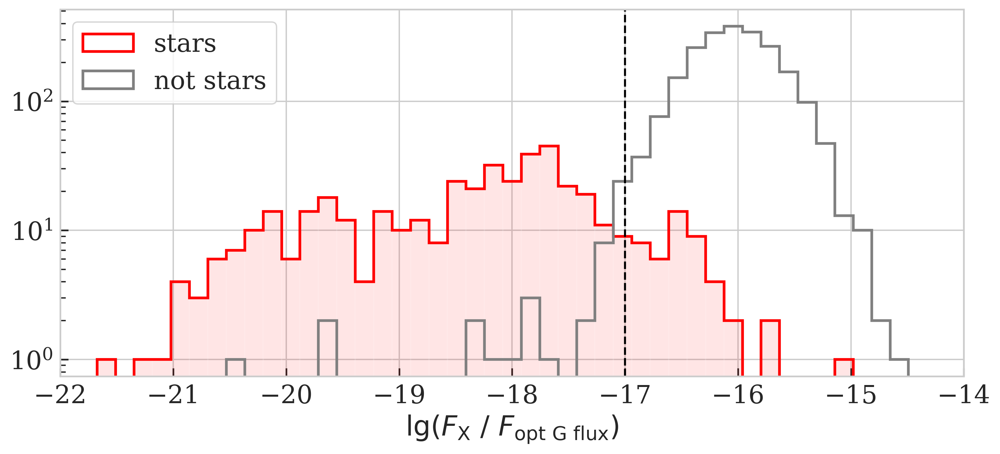

In [34]:
fig, ax = plt.subplots(figsize=(12, 5))

binspase = np.linspace(-22, -14, 50)

stars_xo = np.log10(lh_dr3_stars_df['flux_05-20'] / lh_dr3_stars_df['phot_g_mean_flux'])
notstars_x0 = np.log10(lh_dr3_notstars_df['flux_05-20'] / lh_dr3_notstars_df['phot_g_mean_flux'])
# notstars_x0 = gaia_qso_closest_df['log_flux_05-20'] / np.log10(gaia_qso_closest_df['phot_g_mean_flux'])

ax.hist(stars_xo, bins=binspase, color='red', alpha=.1)
ax.hist(stars_xo, bins=binspase, color='red', histtype='step', lw=2, label='stars')

ax.hist(notstars_x0, bins=binspase, color='gray', label='not stars',
        alpha=1, histtype='step', lw=2)

ax.set_xlabel(r'$\lg(F_{\rm X}\ /\ F_{\rm opt\ G\ flux})$')
ax.set_yscale('log')

fx_fopt_const = 17

ax.axvline(-fx_fopt_const, color='black', linestyle='--')
ax.set_xlim(-22, -14)

ax.legend(frameon=True, loc='upper left')

plt.show()

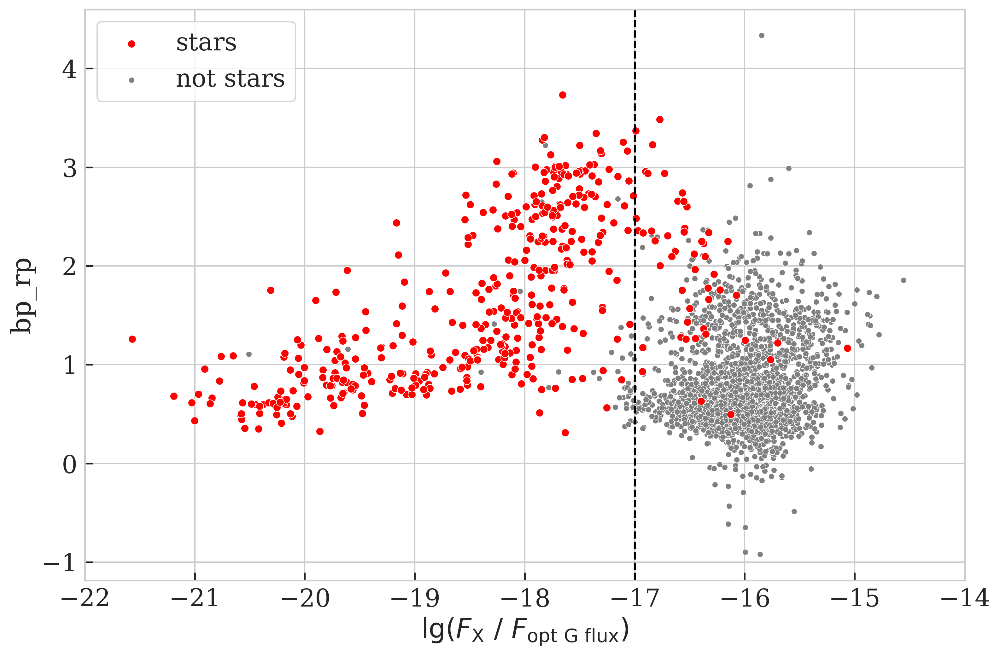

In [35]:
fig, ax = plt.subplots(figsize=(12, 8))

x2o_stars = lh_dr3_stars_df['flux_05-20'] / lh_dr3_stars_df['phot_g_mean_flux']
x2o_nostars = lh_dr3_notstars_df['flux_05-20'] / lh_dr3_notstars_df['phot_g_mean_flux']

sns.scatterplot(x=np.log10(x2o_stars), y=lh_dr3_stars_df['bp_rp'],
                color='red', zorder=2, label='stars')
sns.scatterplot(x=np.log10(x2o_nostars), y=lh_dr3_notstars_df['bp_rp'],
                color='gray', s=20, zorder=1, label='not stars')


ax.set_xlabel(r'$\lg(F_{\rm X}\ /\ F_{\rm opt\ G\ flux})$')
# ax.set_yscale('log')

fx_fopt_const = 17

ax.axvline(-fx_fopt_const, color='black', linestyle='--')
ax.set_xlim(-22, -14)

ax.legend(frameon=True, loc='upper left')

plt.show()

# lg(Fx) / lg(Fopt)

::: {.panel-tabset}

## Color

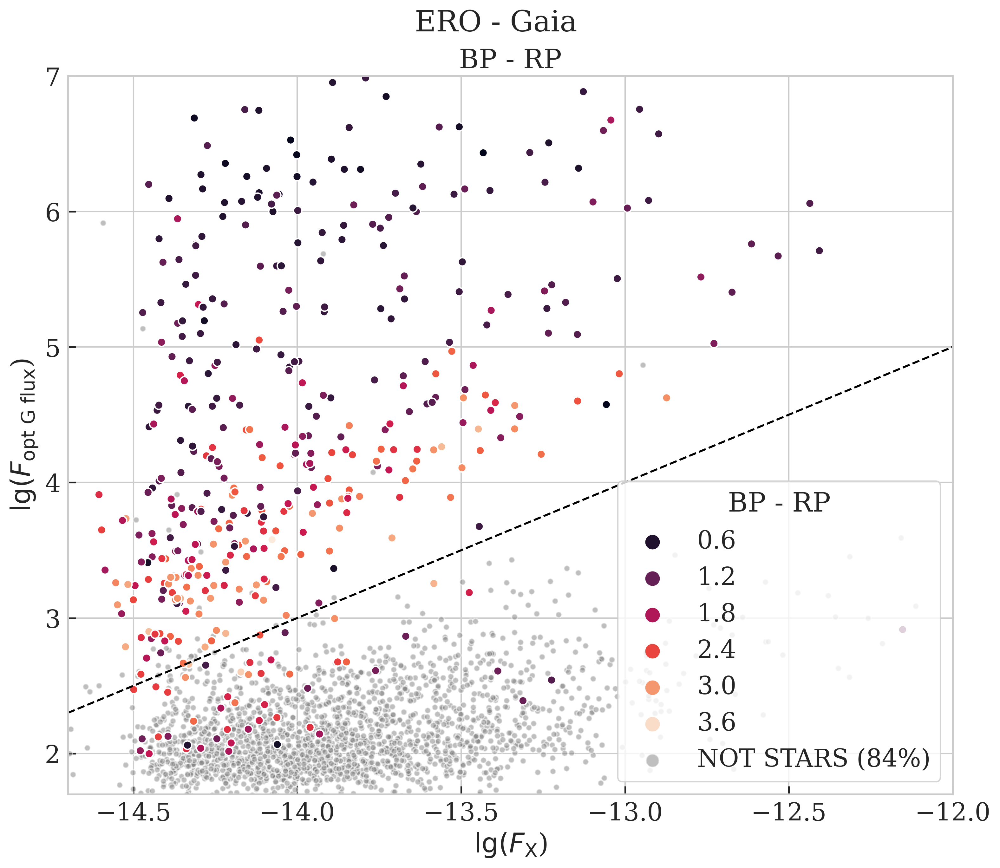

In [36]:
fig, ax = plt.subplots(figsize=(12, 10))

sns.scatterplot(data=lh_dr3_stars_df, x='log_flux_05-20', y='log_phot_g_mean_flux',
                s=40, hue='bp_rp', linewidth=1, palette='rocket', zorder=2)
                # label=f'STARS ({len(lh_dr3_stars_df) / n_gaia_candidates:.0%})')

sns.scatterplot(lh_dr3_notstars_df['log_flux_05-20'],
                np.log10(lh_dr3_notstars_df['phot_g_mean_flux']), s=20, color='gray',
                linewidth=1, alpha=0.5,
                label=f'NOT STARS ({len(lh_dr3_notstars_df) / n_gaia_candidates:.0%})')


gaia_qso_closest_df  = lh_dr3_closest_df[lh_dr3_closest_df['is_qso']==True]

# ax.scatter(gaia_qso_closest_df['log_flux_05-20'], np.log10(gaia_qso_closest_df['phot_g_mean_flux']),
#            marker='+', s=100, alpha=.3, color='g',
#            label=f'QSO ({len(gaia_qso_closest_df)} / {len(lh_dr3_notstars_df)})')

ax.set_ylabel(r'$\lg(F_{\rm opt\ G\ flux}$)')
ax.set_xlabel(r'$\lg(F_{\rm X}$)')

ax.set_ylim(1.7, 7)
ax.set_xlim(-14.7, -12)

lgnd = ax.legend(frameon=True, loc='lower right', title='BP - RP')
for handle in lgnd.legendHandles:
    handle._sizes = [100]

fig.suptitle('ERO - Gaia', fontsize=22, y=.95)
ax.set_title(f'BP - RP')

fx_space = np.linspace(-14.7, -11, 100)
ax.plot(fx_space, fx_space + fx_fopt_const, color='black', linestyle='--')

plt.show()

## Spectral type

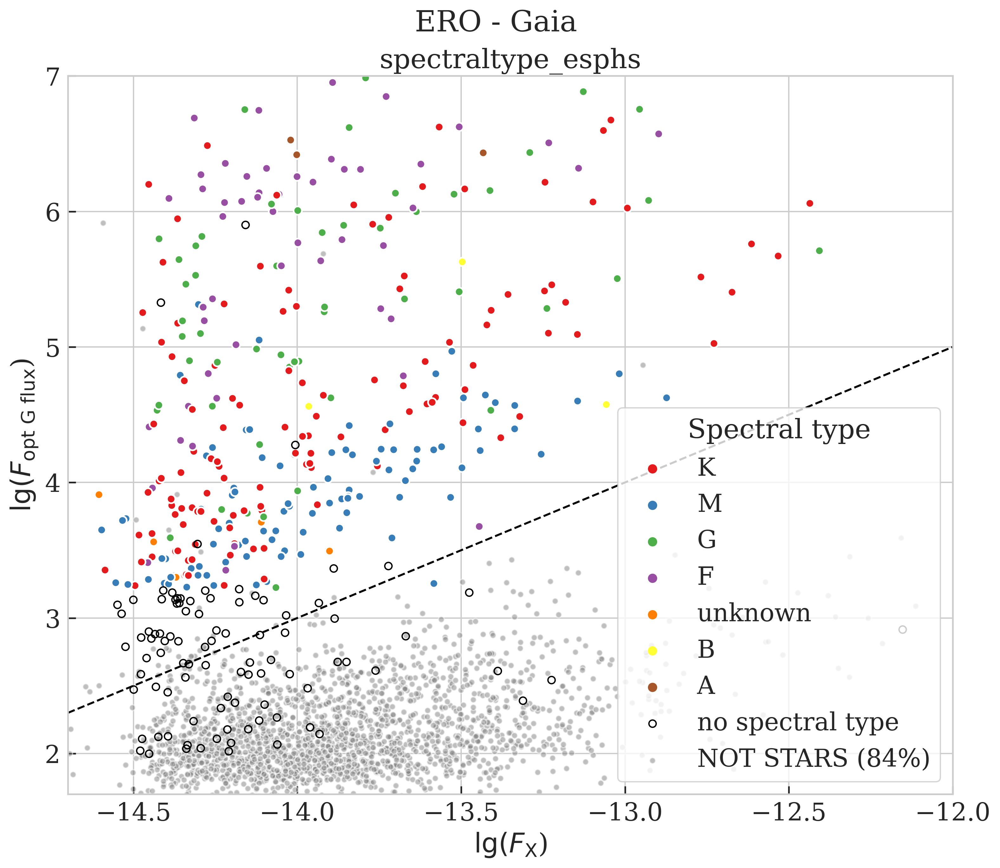

In [37]:
fig, ax = plt.subplots(figsize=(12, 10))

lh_dr3_stars_df['log_phot_g_mean_flux'] = np.log10(lh_dr3_stars_df['phot_g_mean_flux'])
sns.scatterplot(data=lh_dr3_stars_df, x='log_flux_05-20', y='log_phot_g_mean_flux',
                hue='spectraltype_esphs', palette='Set1', linewidth=1.25, zorder=2, s=40)
                # label=f'STARS ({len(lh_dr3_stars_df) / n_gaia_candidates:.0%})')
lh_dr3_no_stype_df = lh_dr3_stars_df[lh_dr3_stars_df['spectraltype_esphs'].isna()]
sns.scatterplot(data=lh_dr3_no_stype_df, x='log_flux_05-20', y='log_phot_g_mean_flux',
                s=30, linewidth=1, zorder=2, edgecolor='k', color='none',
                label=f'no spectral type')

sns.scatterplot(lh_dr3_notstars_df['log_flux_05-20'],
                np.log10(lh_dr3_notstars_df['phot_g_mean_flux']), s=20, color='gray', linewidth=1,
                alpha=0.5, label=f'NOT STARS ({len(lh_dr3_notstars_df) / n_gaia_candidates:.0%})')


gaia_qso_closest_df  = lh_dr3_closest_df[lh_dr3_closest_df['is_qso']==True]

# ax.scatter(gaia_qso_closest_df['log_flux_05-20'], np.log10(gaia_qso_closest_df['phot_g_mean_flux']),
#            marker='+', s=100, alpha=.3, color='g',
#            label=f'QSO ({len(gaia_qso_closest_df)} / {len(lh_dr3_notstars_df)})')

ax.set_ylabel(r'$\lg(F_{\rm opt\ G\ flux}$)')
ax.set_xlabel(r'$\lg(F_{\rm X}$)')

ax.set_ylim(1.7, 7)
ax.set_xlim(-14.7, -12)

lgnd = ax.legend(frameon=True, loc='lower right', title='Spectral type')
# for handle in lgnd.legendHandles:
#     handle._sizes = [100]

fig.suptitle('ERO - Gaia', fontsize=22, y=.95)
ax.set_title(f'spectraltype_esphs')

fx_fopt_const = 17

fx_space = np.linspace(-14.7, -11, 100)
ax.plot(fx_space, fx_space + fx_fopt_const, color='black', linestyle='--')

plt.show()

## Distance

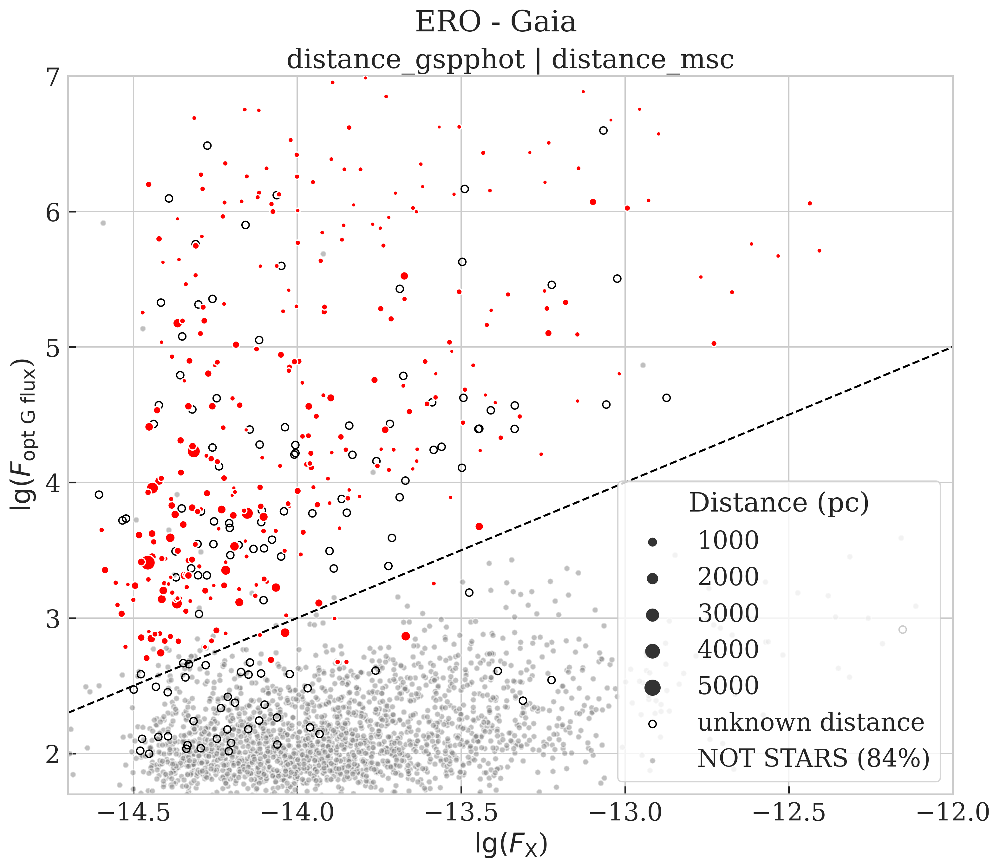

In [38]:
# Назначаю расстояние до звезды в зависимости от вероятности объекта Gaia быть двоной системой
lh_dr3_stars_df['distance'] = np.where(lh_dr3_stars_df['classprob_dsc_combmod_binarystar'] < 0.5,
                                       lh_dr3_stars_df['distance_gspphot'],
                                       lh_dr3_stars_df['distance_msc'])

fig, ax = plt.subplots(figsize=(12, 10))

lh_dr3_stars_df['log_phot_g_mean_flux'] = np.log10(lh_dr3_stars_df['phot_g_mean_flux'])
sns.scatterplot(data=lh_dr3_stars_df, x='log_flux_05-20', y='log_phot_g_mean_flux',
                size='distance', sizes=(10, 130), linewidth=1, zorder=3, color='red')
                # label=f'STARS ({len(lh_dr3_stars_df) / n_gaia_candidates:.0%})')

lh_dr3_no_distance_df = lh_dr3_stars_df[lh_dr3_stars_df['distance'].isna()]
sns.scatterplot(data=lh_dr3_no_distance_df, x='log_flux_05-20', y='log_phot_g_mean_flux',
                s=30, linewidth=1, zorder=2, edgecolor='k', color='none',
                label=f'unknown distance')

sns.scatterplot(lh_dr3_notstars_df['log_flux_05-20'],
                np.log10(lh_dr3_notstars_df['phot_g_mean_flux']), s=20,
                color='gray', alpha=0.5, linewidth=1, zorder=1,
                label=f'NOT STARS ({len(lh_dr3_notstars_df) / n_gaia_candidates:.0%})')


gaia_qso_closest_df  = lh_dr3_closest_df[lh_dr3_closest_df['is_qso']==True]

# ax.scatter(gaia_qso_closest_df['log_flux_05-20'], np.log10(gaia_qso_closest_df['phot_g_mean_flux']),
#            marker='+', s=100, alpha=.3, color='g',
#            label=f'QSO ({len(gaia_qso_closest_df)} / {len(lh_dr3_notstars_df)})')

ax.set_ylabel(r'$\lg(F_{\rm opt\ G\ flux}$)')
ax.set_xlabel(r'$\lg(F_{\rm X}$)')

ax.set_ylim(1.7, 7)
ax.set_xlim(-14.7, -12)

lgnd = ax.legend(frameon=True, loc='lower right', title='Distance (pc)')
# for handle in lgnd.legendHandles:
#     handle._sizes = [100]

fig.suptitle('ERO - Gaia', fontsize=22, y=.95)
ax.set_title(f'distance_gspphot | distance_msc')

fx_fopt_const = 17

fx_space = np.linspace(-14.7, -11, 100)
ax.plot(fx_space, fx_space + fx_fopt_const, color='black', linestyle='--')

plt.show()

## Predicted class

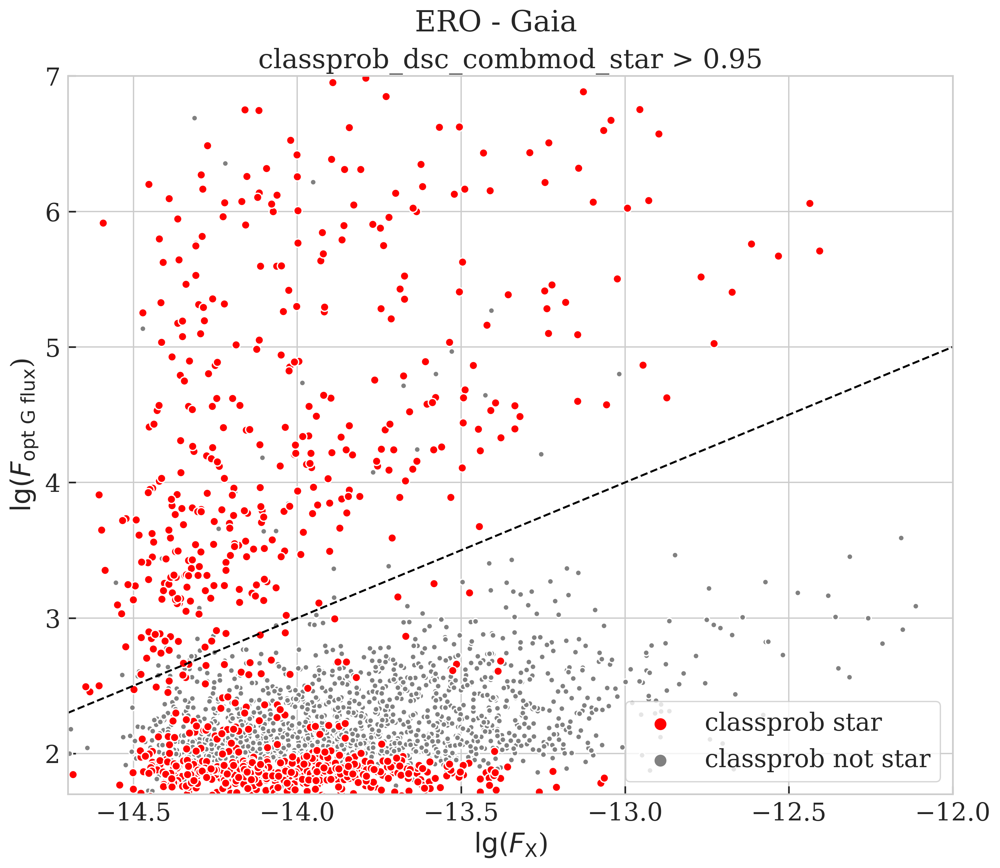

In [39]:
prob_threshold = .95
condition = lh_dr3_closest_df['classprob_dsc_combmod_star'] > prob_threshold
lh_dr3_closest_df['classprob_star'] = np.where(condition, True, False)

star_classprob_df = lh_dr3_closest_df[lh_dr3_closest_df['classprob_star']==True]

fig, ax = plt.subplots(figsize=(12, 10))
sns.scatterplot(data=lh_dr3_closest_df[lh_dr3_closest_df['classprob_star']==True],
                x='log_flux_05-20', y='log_phot_g_mean_flux', s=40, linewidth=1,
                color='r', label='classprob star', zorder=2)

sns.scatterplot(data=lh_dr3_closest_df[lh_dr3_closest_df['classprob_star']==False],
                x='log_flux_05-20', y='log_phot_g_mean_flux', s=20, linewidth=1,
                color='gray', label='classprob not star', zorder=1)

fx_space = np.linspace(-14.7, -11, 100)
ax.plot(fx_space, fx_space + fx_fopt_const, color='black', linestyle='--')

ax.set_ylabel(r'$\lg(F_{\rm opt\ G\ flux}$)')
ax.set_xlabel(r'$\lg(F_{\rm X}$)')

fig.suptitle('ERO - Gaia', fontsize=22, y=.95)
ax.set_title(f'classprob_dsc_combmod_star > {prob_threshold}')

ax.set_ylim(1.7, 7)
ax.set_xlim(-14.7, -12)

lgnd = ax.legend(frameon=True, loc='lower right')
for handle in lgnd.legendHandles:
    handle._sizes = [100]

plt.show()

:::

In [40]:
lh_desi_init_df = Table.read('data/correlations/lh_radec_fin_desi_30sec.fits')

desi_columns = ['srcname_fin', 'RA_fin', 'DEC_fin', 'sep', 'release', 'brickid',
                'objid', 'brick_primary', 'type', 'ra', 'dec', 'ra_ivar', 'dec_ivar',
                'flux_g', 'flux_r', 'flux_z', 'flux_w1', 'flux_w2', 'flux_w3', 'flux_w4',
                'flux_ivar_g', 'flux_ivar_r', 'flux_ivar_z', 'flux_ivar_w1', 'flux_ivar_w2',
                'flux_ivar_w3', 'flux_ivar_w4', 'pmra', 'pmdec', 'parallax',
                'pmra_ivar', 'pmdec_ivar', 'parallax_ivar']

lh_desi_init_df = lh_desi_init_df[desi_columns].to_pandas()
lh_desi_init_df['srcname_fin'] = lh_desi_init_df['srcname_fin'].astype(str).str[2:-1]

lh_desi_init_df['desi_id'] = lh_desi_init_df['release'].astype(str) + '_' + \
                             lh_desi_init_df['brickid'].astype(str) + '_' + \
                             lh_desi_init_df['objid'].astype(str)

lh_desi_init_df = lh_desi_init_df[lh_desi_init_df['brick_primary']==True]

# # Transform fluxes to magnitude
# for flux_name in ['flux_g', 'flux_r', 'flux_z',
#                   'flux_w1', 'flux_w2', 'flux_w3', 'flux_w4']:
#     lh_desi_init_df['mag_' + flux_name.split('_')[1]] = dcx.flux2mag(lh_desi_init_df[flux_name])

# lh_desi_init_df.to_pickle('data/correlations/lh_radec_fin_desi_30sec_slim.gz_pkl', compression='gzip')

n_duplicates = lh_desi_init_df.duplicated(subset=['RA_fin', 'DEC_fin', 'ra', 'dec']).sum()
print(f'Duplicates: {n_duplicates}')
print()

# Дополнительные признаки eROSITA
additional_columns = ['srcname_fin', 'pos_r98',
                      'DET_LIKE_0', 'EXT_LIKE',
                      'flux_05-20', 'pos_sigma_2d']
lh_slim_df = lh_df[additional_columns]
lh_desi_init_df = lh_desi_init_df.merge(lh_slim_df, on='srcname_fin', how='left')

# Фильтр по рентгеновским свойствам
lh_desi_init_df = lhf.xray_filtration(lh_desi_init_df, DL_thresh=DL_min,
                                      EL_thresh=EL_max, verbouse=False)

# # Все объекты DESI в 30" от надежных ERO (для WWT)
# (Table.from_pandas(lh_desi_init_df.drop_duplicates(subset=['desi_id']))
# .write('/Users/mike/Repos/WWT/data/lh_desi_30sec.fits', format='fits'))

# Фильтр по r98
lh_desi_df = lhf.pos_r_filter(lh_desi_init_df, sep_cname='sep')

# Вычисляю звездную величину в фильтре w1 и перевожу ее в Янски
# lh_desi_df = lhf.vega_preprocess(lh_desi_df)
# lh_desi_df['W1_Jy_desi'] = lhf.ab_mag2Jy(lh_desi_df['w1_vega_mag'])

DR16Q_path = '/Users/mike/Repos/csc_xmm/data/DR16Q_v4_SLIM.gz_pkl'

drq_df = pd.read_pickle(DR16Q_path, compression='gzip')
# Перевожу звездную величину в фильтре w1 (vega) в Янски
drq_df['W1_Jy_qso'] = dcx.wise_vega2jansky(drq_df['W1_MAG'])

# Отмечает объекты DESI, у которых в 1" есть квазар SDSS значение True в колонке 'is_qso',
# остальным объектам присваивается False
qso_lh_df = lhf.qso_marker(drq_df, lh_desi_df)

# Количество звезд и квазаров в окружении ERO
neighbour_stat = qso_lh_df.groupby('srcname_fin')['is_qso'].agg(['sum', 'count'])
neighbour_stat.columns = ['n_qso', 'n_neighbours']
neighbour_stat['n_stars'] = neighbour_stat['n_neighbours'] - neighbour_stat['n_qso']

qso_lh_stat_df = qso_lh_df.merge(neighbour_stat, on='srcname_fin', how='left')

# Только ближайшие источники
desi_qso_df = lhf.leave_closest_sep(qso_lh_stat_df, sep_name='sep')
n_candidates = len(desi_qso_df)

desi_qso_df['log_flux_05-20'] = np.log10(desi_qso_df['flux_05-20'])

# Mark stars according to Gaia DR2
desi_dr2_stars_id = lhf.star_extraction(desi_qso_df, s_n_threshold=4, optic_cat='desi')['desi_id']
desi_qso_df['is_dr2_star'] = desi_qso_df['desi_id'].isin(desi_dr2_stars_id)

Duplicates: 0

pos_r98 correction (pos_r98_corr)
- - - - - 
Coefficient: 1.1
Lower threshold: 5

Weak ERO sources in X-ray duplicates removed (temporary measure)

Before max separation filter: 101482
After max separation filter: 12273

Correlating DESI candidates with SDSS QSOs in 1.0"...

*   *   *   *   *   
Отмечено 1813 квазаров среди всех кандидатов DESI в r_98 (12273)
*   *   *   *   *   
Extracting stars from Gaia catalogue...

S/N threshold: 4 (for parallax & propper motion)

Before stars extraction: 6531
After stars extraction: 337 (5%)



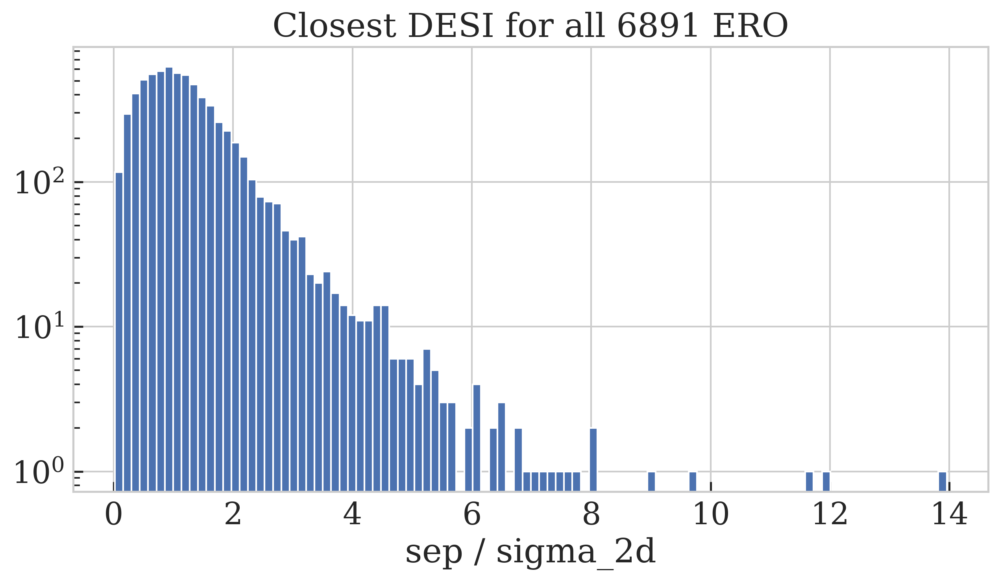

In [41]:
'''
TODO: Add probabilities according to sigma_2d
'''

fig, ax = plt.subplots(figsize=(10, 5))

lh_desi_all_closest_df = lhf.leave_closest_sep(lh_desi_init_df, sep_name='sep')

ax.hist(lh_desi_all_closest_df['sep'] / lh_desi_all_closest_df['pos_sigma_2d'], bins=100)
ax.set_xlabel('sep / sigma_2d')
ax.set_yscale('log')

ax.set_title(f'Closest DESI for all {lh_desi_all_closest_df.srcname_fin.nunique()} ERO')

plt.show()

In [42]:
# fig, ax = plt.subplots(figsize=(12, 12))

# ax.scatter(lh_dr3_stars_df['log_flux_05-20'],
#            lh_dr3_stars_df['phot_g_mean_mag'], s=10, color='red',
#            label=f'STARS ({len(lh_dr3_stars_df) / n_gaia_candidates:.0%})', zorder=2)

# ax.scatter(lh_dr3_notstars_df['log_flux_05-20'],
#            lh_dr3_notstars_df['phot_g_mean_mag'], s=10, color='gray', alpha=0.5,
#            label=f'NOT STARS ({len(lh_dr3_notstars_df) / n_gaia_candidates:.0%})')

# gaia_qso_closest_df  = lh_dr3_closest_df[lh_dr3_closest_df['is_qso']==True]

# ax.scatter(gaia_qso_closest_df['log_flux_05-20'], gaia_qso_closest_df['phot_g_mean_mag'],
#            marker='+', s=100, alpha=.3, color='g',
#            label=f'QSO ({len(gaia_qso_closest_df)} / {len(lh_dr3_notstars_df)})')

# ax.set_ylabel('g mag')
# ax.set_xlabel(r'$\lg(F_{\rm X}$)')

# ax.set_ylim(7, 27)
# ax.set_xlim(-14.7, -12.5)

# lgnd = ax.legend(frameon=True, loc='lower right')
# for handle in lgnd.legendHandles:
#     handle._sizes = [100]

# ax.set_title(f'number of candidates {n_gaia_candidates}: (closest in r_98)')
# fig.suptitle('ERO - Gaia', fontsize=22, y=.95)

# plt.show()

In [43]:
# NaN and inf statistics

# CLEANING_SUBSET = [lg_f2o_name, 'rel_g_r', 'rel_g_z', 'rel_r_z']
# desi_is_gaia = desi_qso_df[desi_qso_df[GAIA_MARKER_CN]==True]
# print('inf counts:')
# print(desi_is_gaia[CLEANING_SUBSET].isin([-np.inf, np.inf]).sum())
# print()

# desi_is_gaia = desi_qso_df[desi_qso_df[GAIA_MARKER_CN]==True]
# print('NaN counts:')
# print(desi_is_gaia[CLEANING_SUBSET].isna().sum())

# Звезды в LH

In [44]:
gaia_star_mask, gaia_star_d2d, gaia_spec_df = lhf.match_desi2gaia(desi_qso_df, lh_dr3_stars_df)
gaia_star_classprob_mask, _, _ = lhf.match_desi2gaia(desi_qso_df, star_classprob_df)

desi_qso_df['is_gaia_star'] = gaia_star_mask
# Add spectral class based on Gaia DR3 (after crossmatch)
desi_qso_df = desi_qso_df.merge(gaia_spec_df[['desi_id', 'spectraltype_esphs']],
                                on='desi_id', how='left')

desi_qso_df['is_gaia_classprob_star'] = gaia_star_classprob_mask

s1 = set(desi_qso_df[desi_qso_df['is_gaia_star']==True]['desi_id'])
s2 = set(desi_qso_df[desi_qso_df['is_gaia_classprob_star']==True]['desi_id'])

# print(f'classprob: {len(list(s1 & s2)) / len(s1):.0%} of marked stars are the same')

# Dereddended magnitudes
dered_columns = ['desi_id', 'dered_mag_g', 'dered_mag_r', 'dered_mag_z',
                 'dered_mag_w1', 'dered_mag_w2', 'dered_mag_w3', 'dered_mag_w4']

desi_qso_df = desi_qso_df.merge(desi_df[dered_columns], on='desi_id', how='left')

In [45]:
# Calculate reliable magnitudes
desi_qso_phot_df = lhf.reliable_magnitudes(desi_qso_df, s_n_threshold=3)

# Mark ERO object as a star if it has Gaia in r_98
desi_qso_phot_df['is_gaia_star_all'] = desi_qso_phot_df['srcname_fin'].isin(lh_dr3_stars_df['srcname_fin'])

***

:::{.callout-note}

* Источники ERO: (DET_LIKE_0 > 10) & (EXT_LIKE < 6): 6893 / 9500
* Источник DESI в r98: 6531
* Для источников DESI объект GAIA DR3 в 1" c параллаксом/собственным движением: ~315

:::

***

In [46]:
desi_full_len = len(desi_qso_phot_df)

print('Доля источников, для которых определены звездные величины')
print(f'(от {desi_full_len} объектов ERO, для которых в r_98 обнаружен источник DESI):')
print()
print('all_mag_* -- все звездные величины')
print('rel_mag_* -- S/N для потока > 3')
print()

for band in ['g', 'r', 'z', 'w1', 'w2', 'w3', 'w4']:
    for mag_type in ['all_mag', 'rel_mag']:
        final_band = mag_type + '_' + band
        print(f'{final_band}: {sum(~desi_qso_phot_df[final_band].isna() / desi_full_len):.0%}')
    print()

Доля источников, для которых определены звездные величины
(от 6531 объектов ERO, для которых в r_98 обнаружен источник DESI):

all_mag_* -- все звездные величины
rel_mag_* -- S/N для потока > 3

all_mag_g: 99%
rel_mag_g: 92%

all_mag_r: 100%
rel_mag_r: 95%

all_mag_z: 100%
rel_mag_z: 97%

all_mag_w1: 97%
rel_mag_w1: 92%

all_mag_w2: 95%
rel_mag_w2: 87%

all_mag_w3: 75%
rel_mag_w3: 29%

all_mag_w4: 62%
rel_mag_w4: 19%



::: {.panel-tabset}

## $F_{x} / F_{o\ (g)}$

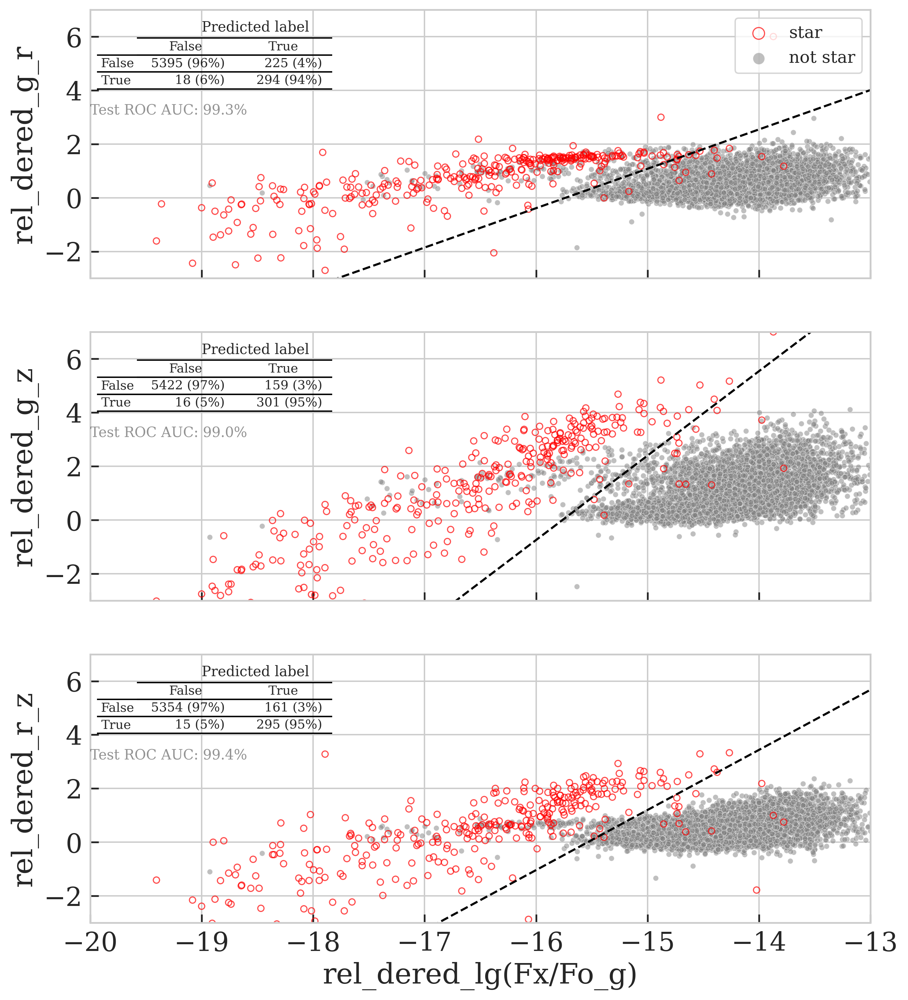

In [90]:
lhf.metaplot(df=desi_qso_phot_df,
             x='rel_dered_lg(Fx/Fo_g)',
             ys=['rel_dered_g_r', 'rel_dered_g_z', 'rel_dered_r_z'],
             star_marker='is_gaia_star')

## $F_{x} / F_{o\ (r)}$

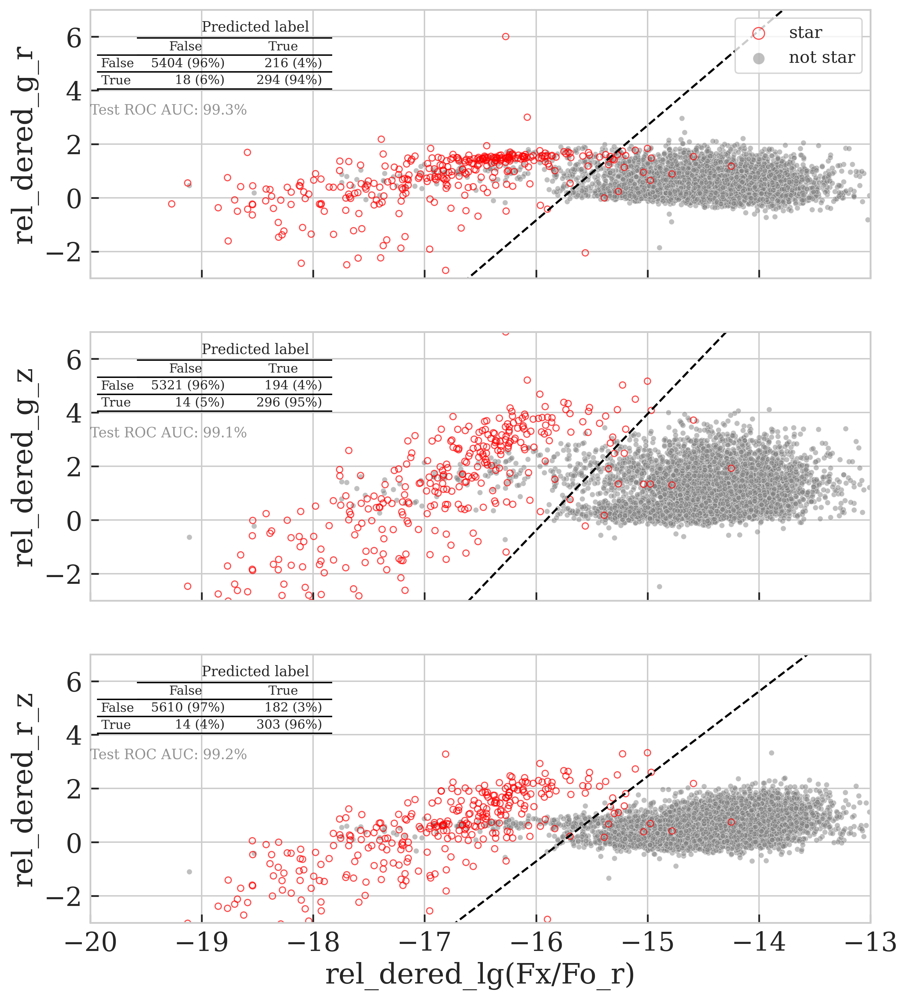

In [91]:
lhf.metaplot(df=desi_qso_phot_df,
             x='rel_dered_lg(Fx/Fo_r)',
             ys=['rel_dered_g_r', 'rel_dered_g_z', 'rel_dered_r_z'],
             star_marker='is_gaia_star')

## $F_{x} / F_{o\ (z)}$

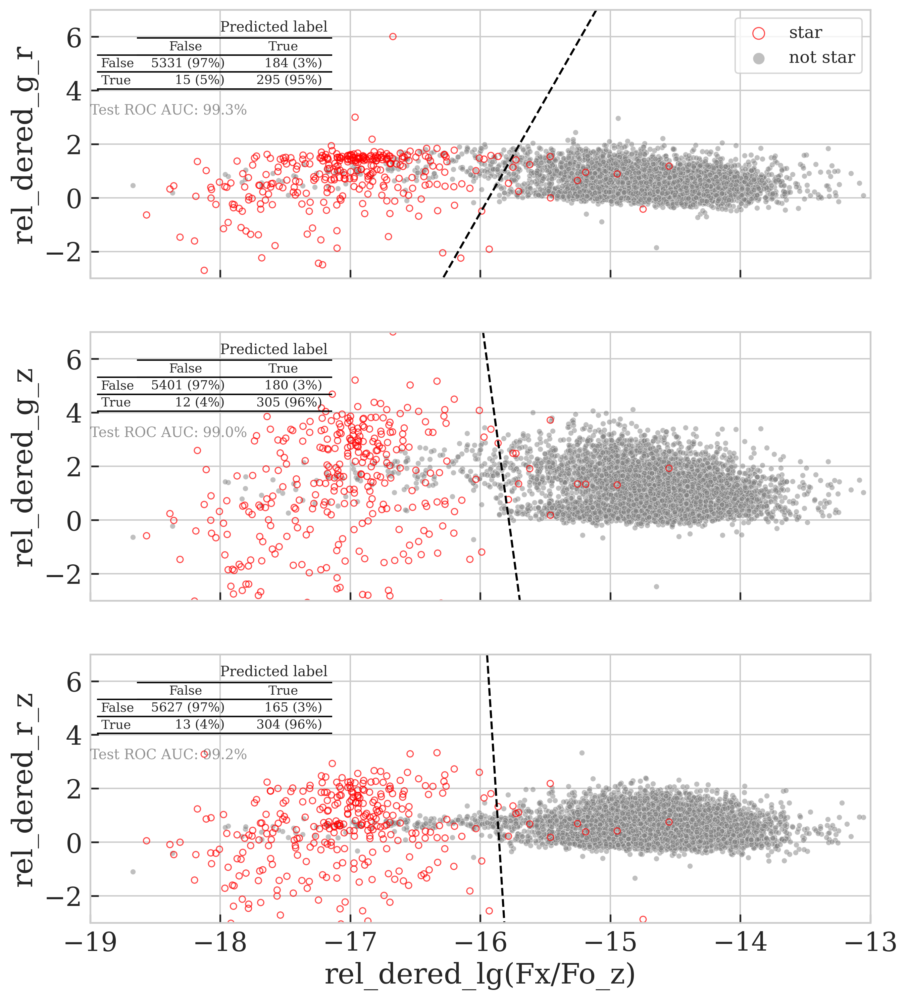

In [128]:
lhf.metaplot(df=desi_qso_phot_df,
             x='rel_dered_lg(Fx/Fo_z)',
             ys=['rel_dered_g_r', 'rel_dered_g_z', 'rel_dered_r_z'],
             star_marker='is_gaia_star')

## $F_{x} / F_{o\ (z)\ corr}$

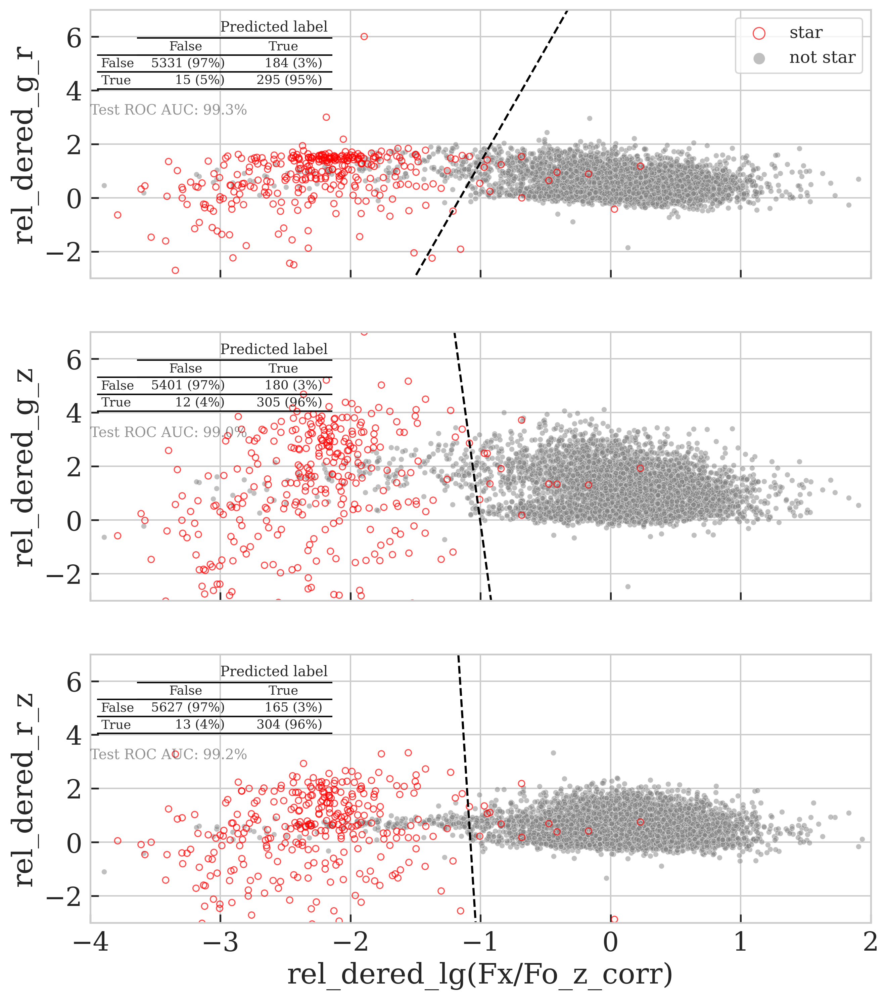

In [112]:
lhf.metaplot(df=desi_qso_phot_df,
             x='rel_dered_lg(Fx/Fo_z_corr)',
             ys=['rel_dered_g_r', 'rel_dered_g_z', 'rel_dered_r_z'],
             star_marker='is_gaia_star',
             band_mode='flux_corr')

:::

<!-- __Согласно SDSS, из 50 "звезд" с самым низким значением цвета g - r 30 объектов являются галактиками__ -->

In [113]:
misclass_stars = desi_qso_phot_df[desi_qso_phot_df['is_gaia_star']==True]
misclass_stars = misclass_stars[misclass_stars['rel_dered_lg(Fx/Fo_z)'] > -15.9]

(misclass_stars.sort_values(by='rel_mag_g')[['ra', 'dec']].reset_index(drop=True))
# .to_csv('data/simbad/star_misclass_coords.txt', sep=' ', index=False, header=False))

(misclass_stars.sort_values(by='rel_mag_g')[['srcname_fin', 'RA_fin', 'DEC_fin', 'ra', 'dec', 'pos_r98', 'pos_r98_corr']]
.reset_index(drop=True)
.to_csv('/Users/mike/Repos/WWT/data/star_misclass_coords.csv', index=False))

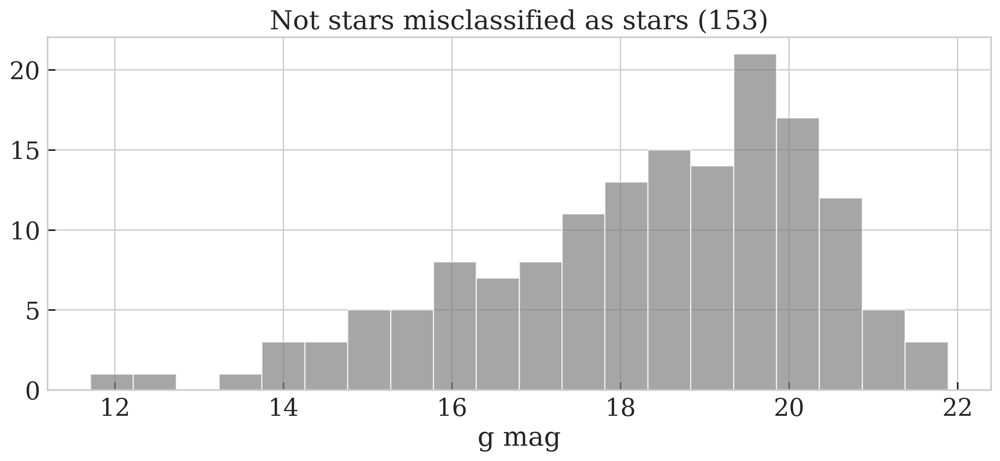

In [114]:
misclass_notstars = desi_qso_phot_df[desi_qso_phot_df['is_gaia_star']==False]
misclass_notstars = misclass_notstars[misclass_notstars['rel_dered_lg(Fx/Fo_z)'] < -15.9]

fig, ax = plt.subplots(figsize=(13, 5))

# sns.jointplot(data=misclass_notstars, x='mag_g', y='mag_r', s=20, height=10)
ax.hist(misclass_notstars['rel_mag_g'], bins=20, alpha=0.7, color='gray')
# ax.axvline(18, color='k', ls='--')

ax.set_title(f'Not stars misclassified as stars ({len(misclass_notstars)})')
ax.set_xlabel('g mag')

plt.show()

In [115]:
(misclass_notstars[['srcname_fin', 'desi_id', 'ra', 'dec', 'rel_mag_g']]
.sort_values(by='rel_mag_g')[['ra', 'dec']]
.reset_index(drop=True)
.to_csv('data/simbad/misclass_notstars_coord.txt', sep=' ', index=False, header=False))

In [116]:
# Файл из Симбада открыть с помощью Numbers/Excel
# Добавить недостающие значения колонок

types_series = pd.read_csv('data/simbad/misclass_notstars_coord_output.csv',
                            sep=';', usecols=[3], ) # , lineterminator='\r'

types_series = types_series.dropna()
types_series.columns = ['type']

# Change LINER-type Active Galaxy Nucleus to LINER AGN
# to avoid 'type' confusion
liner_mask = (types_series['type'] == 'LINER-type Active Galaxy Nucleus')
types_series.loc[liner_mask, 'type'] = 'LINER AGN'

# Drop horizontal splitters
types_series = types_series[~types_series['type'].str.contains('--')]


# Choose only one match for each DESI object
types_series_mask = types_series['type'].str.contains('typ').shift(1).fillna(False)

types_series = types_series[types_series_mask].reset_index(drop=True)

# Drop trailing spaces
types_series['type'] = types_series['type'].str.strip()

print(f'В 3" Симбад находит объект для {len(types_series)} из {len(misclass_notstars)}\
 ({len(types_series) / len(misclass_notstars):.0%}) незвезд, \nлежащих в левой части графика. \
Из них:')

В 3" Симбад находит объект для 79 из 153 (52%) незвезд, 
лежащих в левой части графика. Из них:


* Галактики: 63%

* АЯГи: 17%

* _Звезды_: 5%

* Остальное: 15%

In [117]:
simbad_stat_df = pd.DataFrame(types_series.value_counts(normalize=True)).round(2)

simbad_stat_df.loc[:, 0]

type                               
Galaxy                                 0.35
Active Galaxy Nucleus                  0.13
Brightest Galaxy in a Cluster (BCG)    0.10
Radio Source                           0.08
Quasar                                 0.06
Radio Galaxy                           0.05
Seyfert 1 Galaxy                       0.05
Seyfert 2 Galaxy                       0.05
LINER AGN                              0.04
Emission-line galaxy                   0.03
High Proper Motion Star                0.03
Cluster of Galaxies                    0.01
Eruptive Variable                      0.01
Star                                   0.01
Name: 0, dtype: float64

***

::: {.panel-tabset}

## spurious matches included

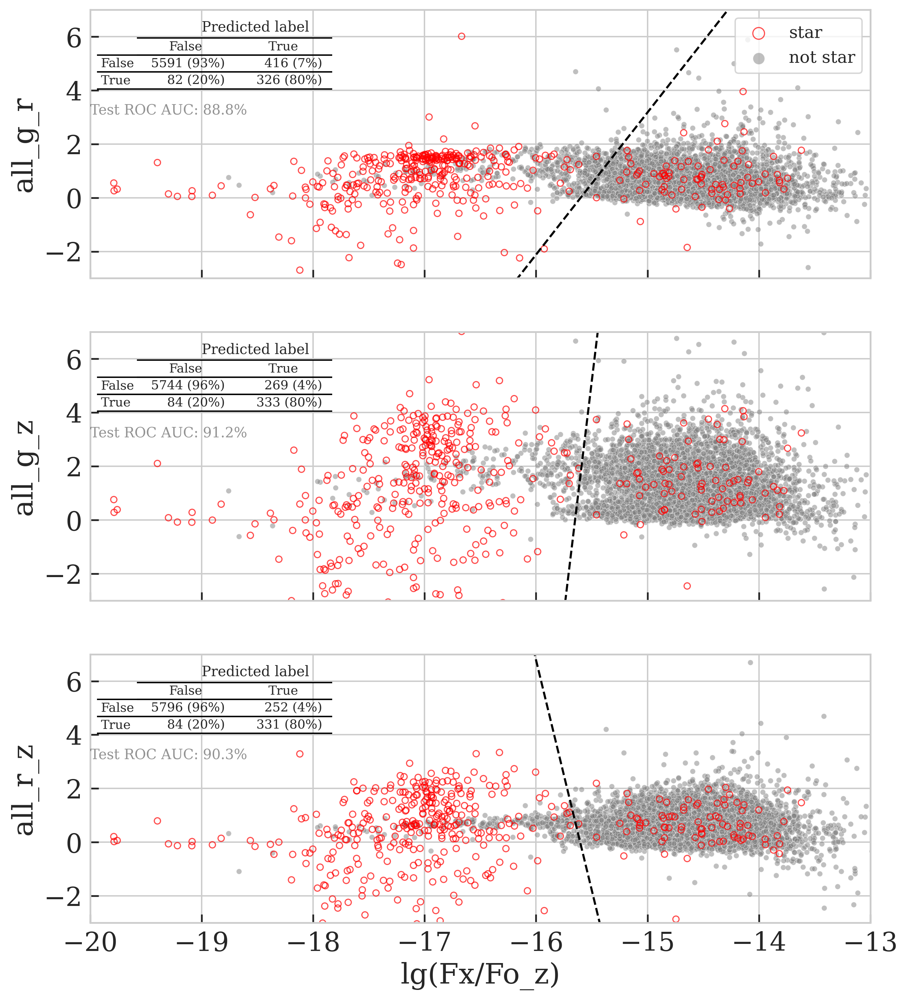

In [118]:
lhf.metaplot(df=desi_qso_phot_df,
             x='lg(Fx/Fo_z)',
             ys=['all_g_r', 'all_g_z', 'all_r_z'],
             star_marker='is_gaia_star_all')

## no spurious matches

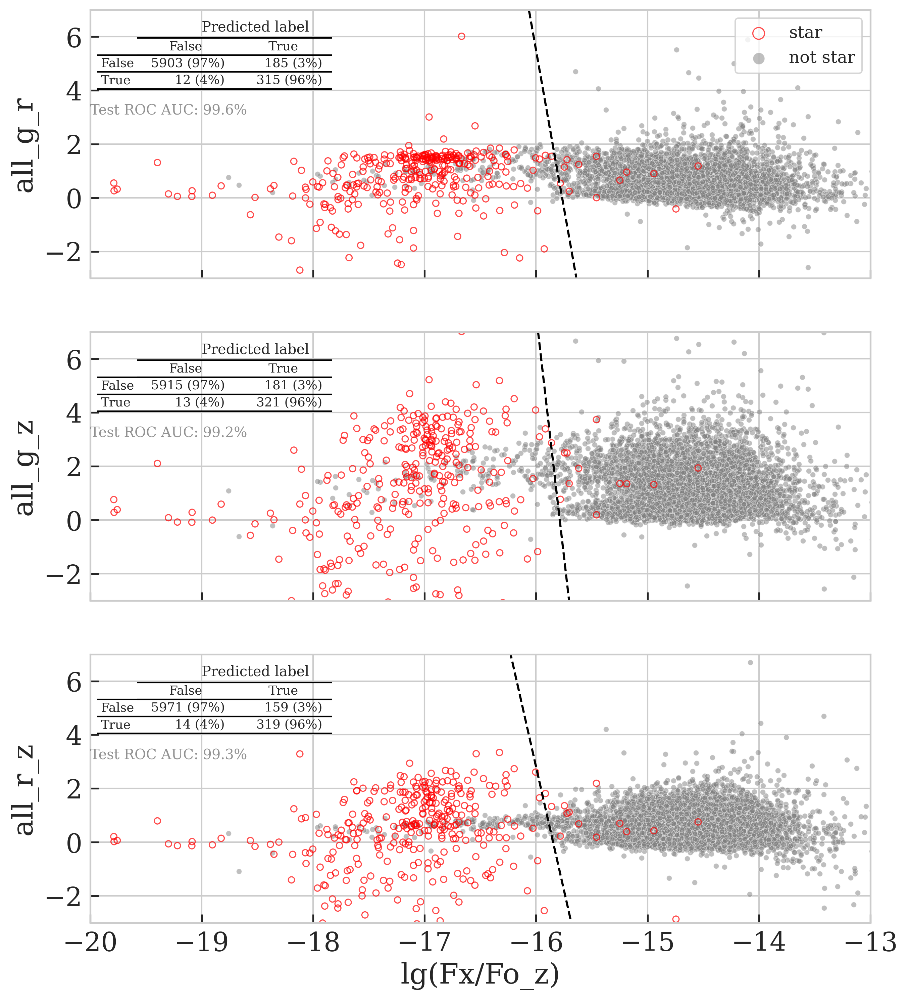

In [119]:
lhf.metaplot(df=desi_qso_phot_df,
             x='lg(Fx/Fo_z)',
             ys=['all_g_r', 'all_g_z', 'all_r_z'],
             star_marker='is_gaia_star')

## reliable magnitudes ($S/N > 3$) -    -    -    -    -    -    -    -    -    -    -    -    -    -    -    -    -

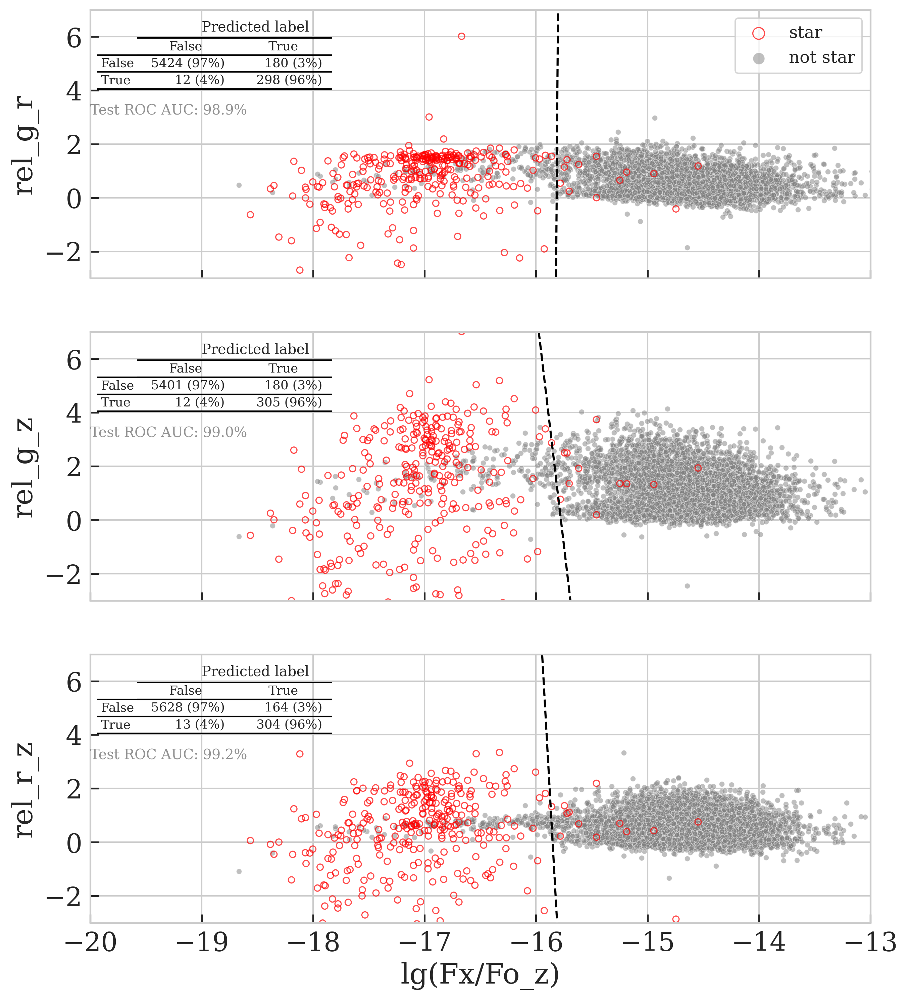

In [120]:
lhf.metaplot(df=desi_qso_phot_df,
             x='lg(Fx/Fo_z)',
             ys=['rel_g_r', 'rel_g_z', 'rel_r_z'],
             star_marker='is_gaia_star')

## reliable and dereddened magnitudes

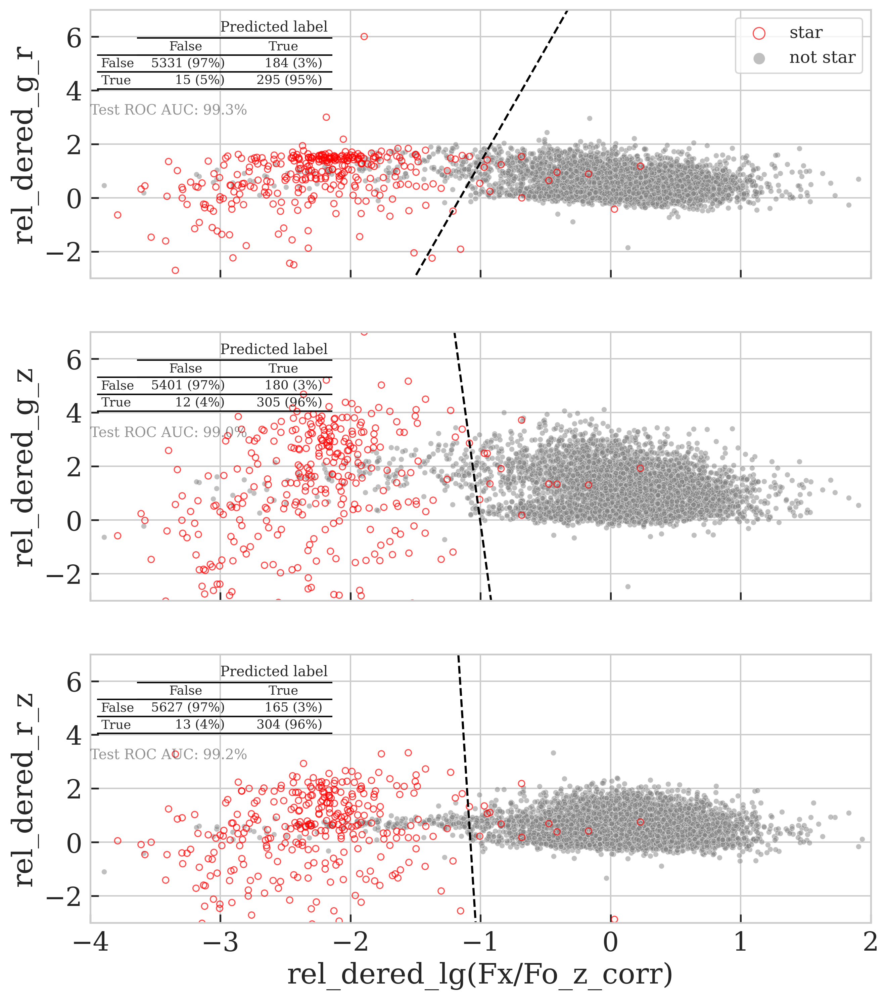

In [121]:
lhf.metaplot(df=desi_qso_phot_df,
             x='rel_dered_lg(Fx/Fo_z_corr)',
             ys=['rel_dered_g_r', 'rel_dered_g_z', 'rel_dered_r_z'],
             star_marker='is_gaia_star',
             band_mode='flux_corr')

<!-- ## DR3 classprob star -->

:::

In [103]:
# lg_f2o_name = 'lg(Fx/Fo_z)'
# ys = ['rel_g_r', 'rel_g_z', 'rel_r_z']
# GAIA_MARKER_CN = 'is_gaia_classprob_star'

# desi_gaia_star_df = desi_qso_phot_df[desi_qso_phot_df[GAIA_MARKER_CN]==True]
# desi_gaia_notstar_df = desi_qso_phot_df[desi_qso_phot_df[GAIA_MARKER_CN]==False]

# clf_z2_gr, test_z2_gr, cnfsn_z2_gr = lhf.star_slope(desi_qso_phot_df,
#                                                     [lg_f2o_name, ys[0]],
#                                                      gaia_marker_cn=GAIA_MARKER_CN)
# clf_z2_gz, test_z2_gz, cnfsn_z2_gz = lhf.star_slope(desi_qso_phot_df,
#                                                     [lg_f2o_name, ys[1]],
#                                                     gaia_marker_cn=GAIA_MARKER_CN)
# clf_z2_rz, test_z2_rz, cnfsn_z2_rz = lhf.star_slope(desi_qso_phot_df,
#                                                     [lg_f2o_name, ys[2]],
#                                                     gaia_marker_cn=GAIA_MARKER_CN)

# lhf.plot_scatter(star_df=desi_gaia_star_df,
#                  notstar_df=desi_gaia_notstar_df,
#                  ys=ys,
#                  x=lg_f2o_name,
#                  classifiers=[clf_z2_gr, clf_z2_gz, clf_z2_rz],
#                  matrices=[cnfsn_z2_gr, cnfsn_z2_gz, cnfsn_z2_rz],
#                  test_metrics=[test_z2_gr, test_z2_gz, test_z2_rz])

## Цвета WISE

::: {.panel-tabset}

## W1

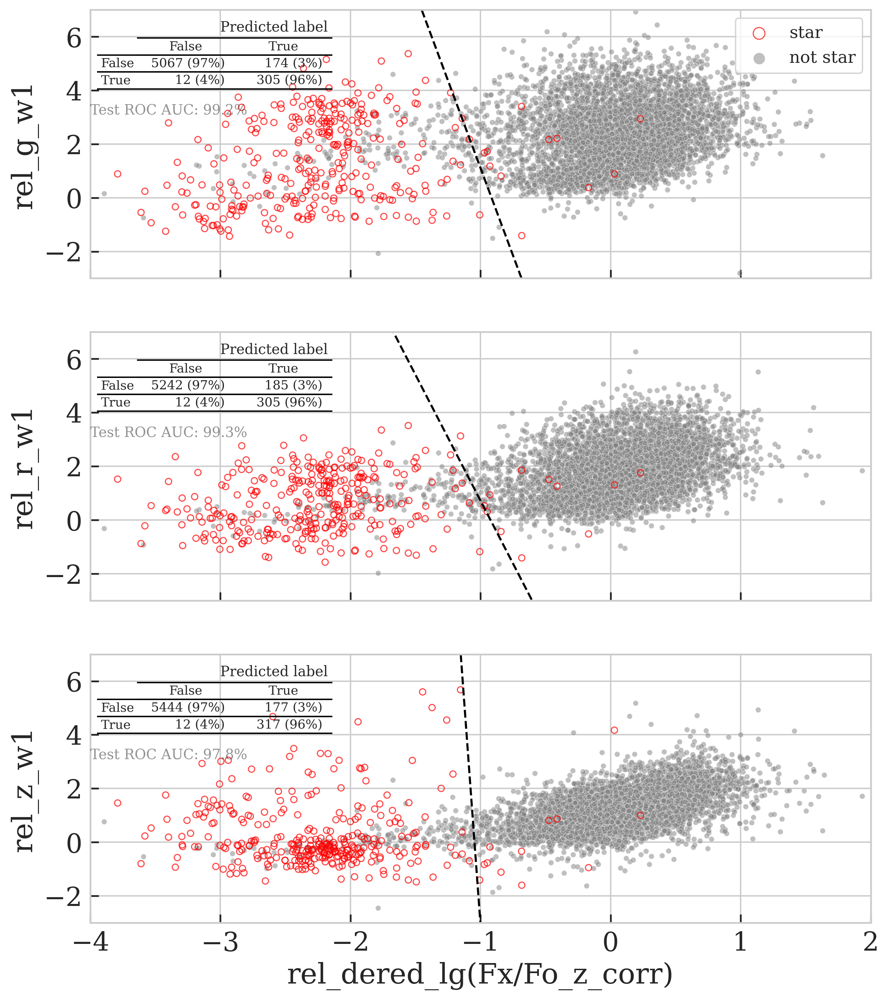

In [123]:
lhf.metaplot(df=desi_qso_phot_df,
             x='rel_dered_lg(Fx/Fo_z_corr)',
             ys=['rel_g_w1', 'rel_r_w1', 'rel_z_w1'],
             star_marker='is_gaia_star',
             band_mode='flux_corr')

## W2

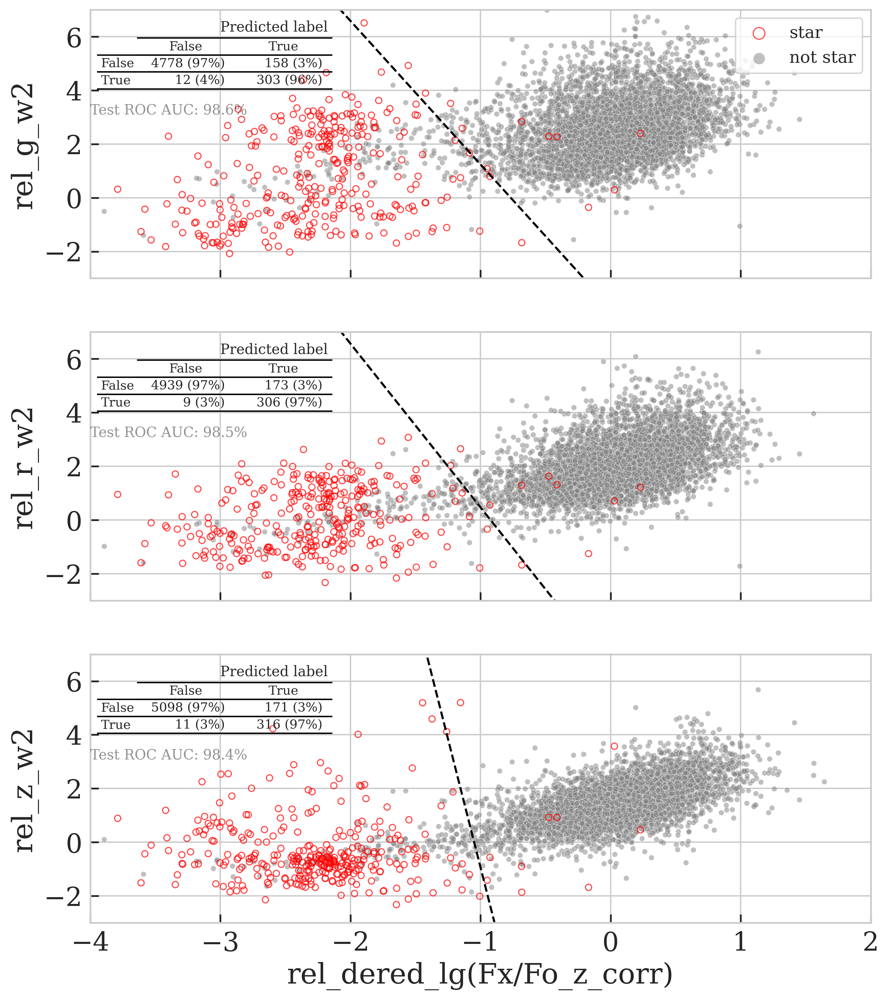

In [124]:
lhf.metaplot(df=desi_qso_phot_df,
             x='rel_dered_lg(Fx/Fo_z_corr)',
             ys=['rel_g_w2', 'rel_r_w2', 'rel_z_w2'],
             star_marker='is_gaia_star',
             band_mode='flux_corr')

## Only infrared

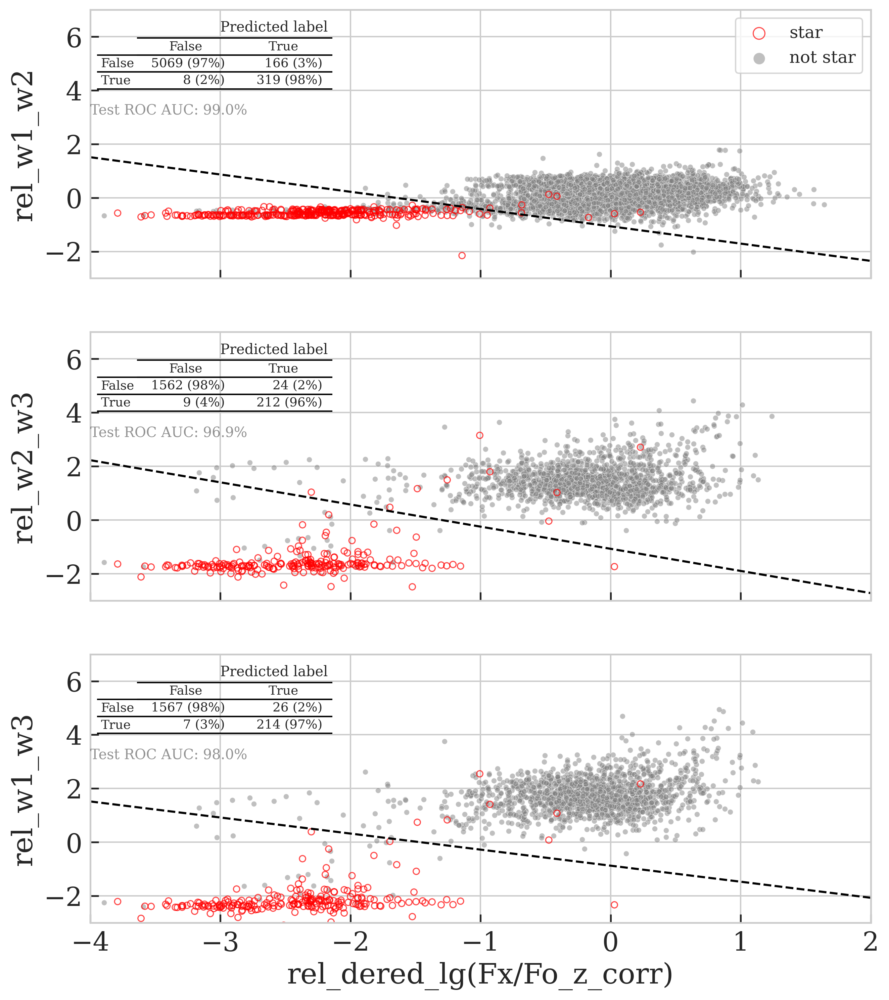

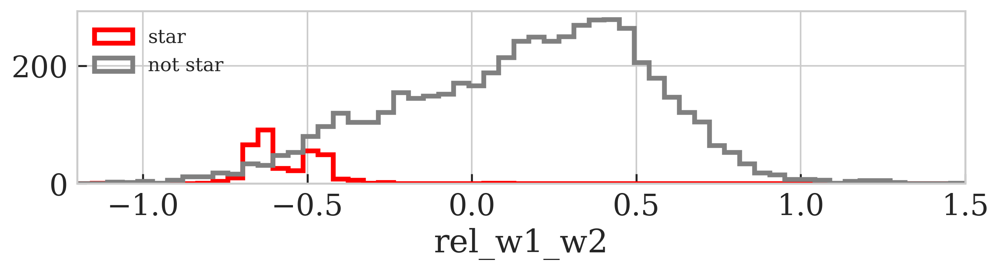

In [125]:
lhf.metaplot(df=desi_qso_phot_df,
             x='rel_dered_lg(Fx/Fo_z_corr)',
             ys=['rel_w1_w2', 'rel_w2_w3', 'rel_w1_w3'],
             star_marker='is_gaia_star',
             band_mode='flux_corr')

## Vega infrared

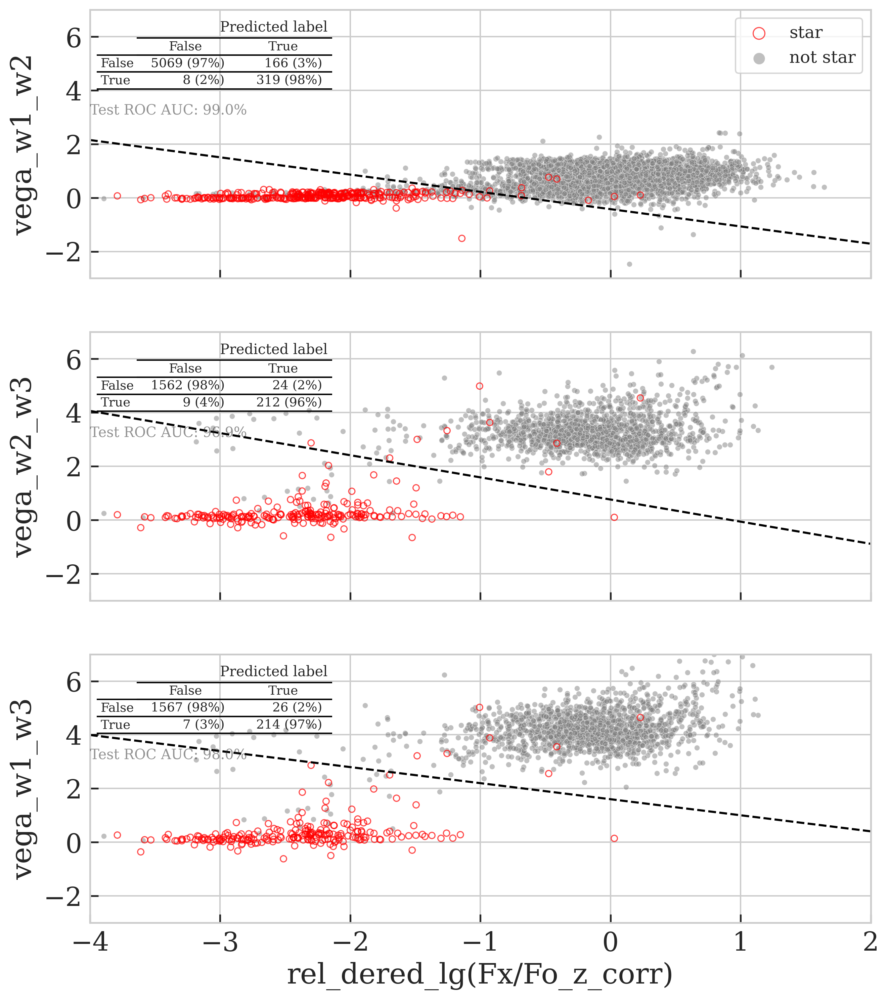

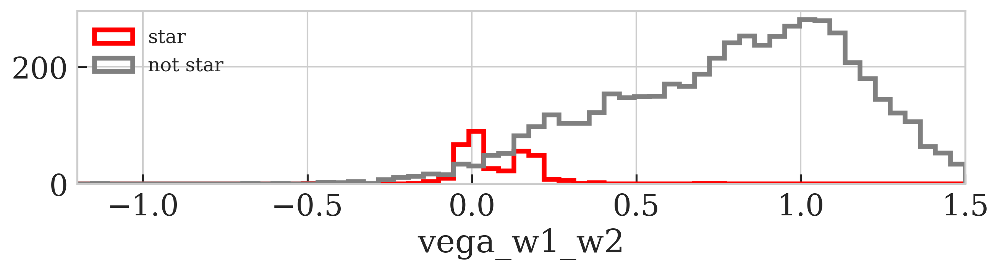

In [126]:
lhf.metaplot(df=desi_qso_phot_df,
             x='rel_dered_lg(Fx/Fo_z_corr)',
             ys=['vega_w1_w2', 'vega_w2_w3', 'vega_w1_w3'],
             star_marker='is_gaia_star',
             band_mode='flux_corr')

:::

![J. Comparat et al.: DR16 SPIDERS point sources](/Users/mike/Documents/Снимок экрана 2022-07-27 в 09.37.39.png)

<!-- ::: {.column-margin}
![J. Comparat et al.: DR16 SPIDERS point sources](/Users/mike/Documents/Снимок экрана 2022-07-27 в 09.37.39.png)
::: -->

***

# Gaia DR3

In [67]:
# fig, ax = plt.subplots(figsize=(12, 10))

# ax.scatter(lh_dr3_stars_df['log_flux_05-20'],
#            lh_dr3_stars_df['phot_g_mean_mag'], s=10, color='red',
#            label=f'stars ({len(lh_dr3_stars_df) / n_gaia_candidates:.0%})', zorder=2)

# # ERO-звезды с одной или более незвездой в r98
# suspicious_star_df = lh_dr3_stars_df[lh_dr3_stars_df['n_not_star'] >= 1]
# ax.scatter(suspicious_star_df['log_flux_05-20'],
#            suspicious_star_df['phot_g_mean_mag'],
#            marker='s', zorder=4, s=150, edgecolor='k', color='none',
#            label=r'stars with $\geq 1$ not stars in r_98')

# # ERO-звезды с более чем одной звездой в r98
# suspicious_several_star_df = lh_dr3_stars_df[lh_dr3_stars_df['n_star'] > 1]
# ax.scatter(suspicious_several_star_df['log_flux_05-20'],
#            suspicious_several_star_df['phot_g_mean_mag'],
#            marker='x', zorder=4, s=100, color='k', alpha=.5,
#            label=r'stars with > 1 stars in r_98')

# ax.scatter(lh_dr3_notstars_df['log_flux_05-20'],
#            lh_dr3_notstars_df['phot_g_mean_mag'], s=10, color='gray', alpha=0.5,
#            label=f'not stars ({len(lh_dr3_notstars_df) / n_gaia_candidates:.0%})')

# # ERO-незвезды с одной или более звездой в r98
# suspicious_not_star_df = lh_dr3_notstars_df[lh_dr3_notstars_df['n_star'] >= 1]
# ax.scatter(suspicious_not_star_df['log_flux_05-20'],
#            suspicious_not_star_df['phot_g_mean_mag'],
#            marker='D', zorder=4, s=120, edgecolor='royalblue', color='none',
#            label=r'not stars with $\geq 1$ stars in r_98')

# # ERO-незвезды с более чем одной незвездой в r98
# suspicious_several_notstar_df = lh_dr3_notstars_df[lh_dr3_notstars_df['n_not_star'] > 1]
# ax.scatter(suspicious_several_notstar_df['log_flux_05-20'],
#            suspicious_several_notstar_df['phot_g_mean_mag'],
#            marker='+', zorder=4, s=100, color='royalblue', alpha=.9,
#            label=r'not stars with > 1 not stars in r_98')



# ax.set_ylabel('g mag')
# ax.set_xlabel('log(flux)')

# ax.set_ylim(7, 23)
# ax.set_xlim(-14.7, -12.5)

# lgnd = ax.legend(frameon=True, loc='lower right')
# for handle in lgnd.legendHandles:
#     handle._sizes = [100]

# ax.set_title(f'number of candidates {n_gaia_candidates}: (closest in r_98)')
# fig.suptitle('ERO - Gaia', fontsize=22, y=.95)

# plt.show()

# * Выделены три категории объектов: звезды, квазары и *остальное*
# * Классы объектов на графике не пересекаются (квазар не может быть одновременно звездой и наоборот)

* [Object classifications](https://www.aanda.org/articles/aa/pdf/forth/aa43423-22.pdf) for 1.59 billion sources (quasars, galaxies, stars, white dwarfs, and physical binary stars)

> The Discrete Source Classifier (DSC) module provides classification probabilities associated with five types of sources: _quasars, galaxies, stars, white dwarfs_, and _physical binary stars_ ... The Quasi Stellar Object Classifier (QSOC) and the Unresolved Galaxy Classifier (UGC) determine the redshifts of the sources classified as quasar and galaxy by the DSC module.

>Gaia DR3 includes 1591 million sources with DSC classifications; 56 million sources to which the OA (Outlier Analysis) clustering is applied; 1.4 million sources with redshift estimates from UGC; 6.4 million sources with QSOC redshift; and 3.1 million level 9 HEALPixes of size 0.013 deg$^2$ where the extinction is evaluated by TGE.

* [Кандидаты в квазары](https://www.aanda.org/articles/aa/pdf/forth/aa43232-22.pdf), большинство с оценкой красного смещения ($6.6 \times 10^6$)
* Переменные АЯГи (872 228)
* Some 1.1 million quasars analysed with 60,000 host galaxies detected and 15,000 surface brightness profiles of the host galaxy

In [68]:
# Рентген к оптике
# fig, ax = plt.subplots(figsize=(12, 8))

# xlim = [.1, 2]

# xspace = np.logspace(*xlim, 50)

# xray2optic_star = lh_dr3_stars_df['log_flux_05-20'] / np.log10(lh_dr3_stars_df['phot_g_mean_flux'])
# xray2optic_star.hist(bins=xspace, lw=2, histtype='step', color='C0', ax=ax)
# xray2optic_star.hist(bins=xspace, lw=2, label='star', alpha=.2, color='C0', ax=ax)

# xray2optic_qso = lh_dr3_notstars_df['log_flux_05-20'] / np.log10(lh_dr3_notstars_df['phot_g_mean_flux'])
# xray2optic_qso.hist(bins=xspace, lw=2, histtype='step', label='qso', color='C1', ax=ax)

# # ax.set_xticks([2, 3, 4, 10])
# # ax.get_xaxis().set_major_formatter(matplotlib.ticker.ScalarFormatter())

# ax.legend()
# # ax.set_xlim(2, 80)

# ax.set_xlabel(r'$\lg(F_{\rm X})\ /\ \lg(F_{\rm opt\ g})$')

# # ax.set_xscale('log')
# # ax.set_yscale('log')

# ax.set_title('ERO - DESI - SDSS DR16Q')

# # fig.savefig('images/qso_star_xray2optic_hist.png', bbox_inches='tight')

# *****************************************************************************

# fig, ax = plt.subplots(figsize=(12, 6))

# max_sep = 60
# sep_space = np.linspace(0, max_sep, 40)

# ax.hist(lh_dr3_closest_star_df['sep_prop'], bins=sep_space, histtype='step',
#         lw=3, color='C2', label='closest neighbours')
# ax.set_xlim(-1, max_sep)

# ax.hist(lh_dr3_closest_star_df['sep_prop'], bins=sep_space,
#         lw=3, color='C2', alpha=.3)

# ax.hist(lh_dr3_stars_df['sep_prop'], bins=sep_space, histtype='step',
#         lw=3, ls='--', color='k', label='all neighbours')

# ax.set_xlim(-1, 60)
# ax.set_ylim(0, 500)

# ax.set_xlabel('separation (arcsec)')
# ax.legend(loc='upper left')

# ax.set_title('ERO - GAIA (only stars)')

# # fig.savefig('images/EDA_plots/gaia_dr2_edr3_comparison.png', bbox_inches='tight')

# plt.show()

# *****************************************************************************

# fig, ax = plt.subplots(figsize=(12, 8))

# ax.hist(lh_gaia3_star_df['sep_prop'], bins=30)

# ax.set_xlabel('separation (arcsec)')
# ax.set_title('Gaia closest star inside r_98')

# plt.show()

# Выделение звезд и квазаров (DESI + SDSS DR16Q)

::: {.callout-note}
В каталоге DESI используются признаки Gaia, поэтому полученные в этой главе звезды (336) будут подвыборкой звезд, найденных в предыдущей главе (437).
:::

```
getaroundr.py -r 30 -cat decals9tr -index srcname_fin -iRA RA_fin -iDEC DEC_fin -i lh_radec_fin.fits -o lh_radec_fin_desi_30sec.fits
```

* После корреляции LH - DESI на hea134 в каталоге оказалось 425 пар рентген-оптика с дублирующимися координатами (`RA_fin`, `DEC_fin`, `ra`, `dec`).

* Подобные дубликаты отсутствуют при корреляции с каталогом Gaia.

::: {.panel-tabset}

## Plot 1

In [63]:
# # fig, ax = plt.subplots(figsize=(12, 5))
# fig, ax = plt.subplots(figsize=(12, 12))

# # Не квазары
# not_qso_df = desi_qso_df[desi_qso_df['is_qso']==False]

# # Фильтр по параллаксу и собственному движению (звезды)
# star_df = lhf.star_extraction(not_qso_df, s_n_threshold=4, optic_cat='desi')

# # Не звезды и не квазары
# not_qso_not_star_df = not_qso_df[~not_qso_df['srcname_fin'].isin(star_df['srcname_fin'])]

# # Квазары
# qso_df = desi_qso_df[desi_qso_df['is_qso']==True]

# ax.scatter(star_df['log_flux_05-20'], star_df['w1_vega_mag'],
#            zorder=3, s=10, color='r',
#            label=f'STARS ({len(star_df) / n_candidates:.0%})', alpha=1)

# ax.scatter(qso_df['log_flux_05-20'], qso_df['W1_MAG'], s=50,
#            color='green', marker='+', label=f'QSO ({len(qso_df) / n_candidates:.0%})',
#            alpha=.7, zorder=2)

# ax.scatter(not_qso_not_star_df['log_flux_05-20'],
#            not_qso_not_star_df['w1_vega_mag'],
#            zorder=1, s=10, color='gray', alpha=.4,
#            label=f'not QSO not STAR ({len(not_qso_not_star_df) / n_candidates:.0%})')
           
# # log_flux_space = np.linspace(-16, -9, 10)
# # ax.plot(log_flux_space, dcx.salvato_w1_line(log_flux_space), lw=2,
# #         color='k', label='Salvato 17')

# ax.set_ylabel('w1 vega mag')
# ax.set_xlabel(r'$\log_{\rm 10}\mathrm{(F_{\rm X, 0.5 - 2})}$')

# ax.set_ylim(7, 23)
# ax.set_xlim(-14.7, -12.5)

# lgnd = ax.legend(frameon=True)
# for handle in lgnd.legendHandles:
#     handle._sizes = [100]

# ax.set_title(f'number of candidates {n_candidates}: (closest in r_98)')
# fig.suptitle('ERO      -    DESI    -    SDSS DR16Q', fontsize=22, y=.95)

# # fig.savefig('images/EDA_plots/star_qso_separation.png', bbox_inches='tight')

# plt.show()

## Plot 2

Extracting stars from Gaia catalogue...

S/N threshold: 4 (for parallax & propper motion)

Before stars extraction: 4925
After stars extraction: 336 (7%)



KeyError: 'w1_vega_mag'

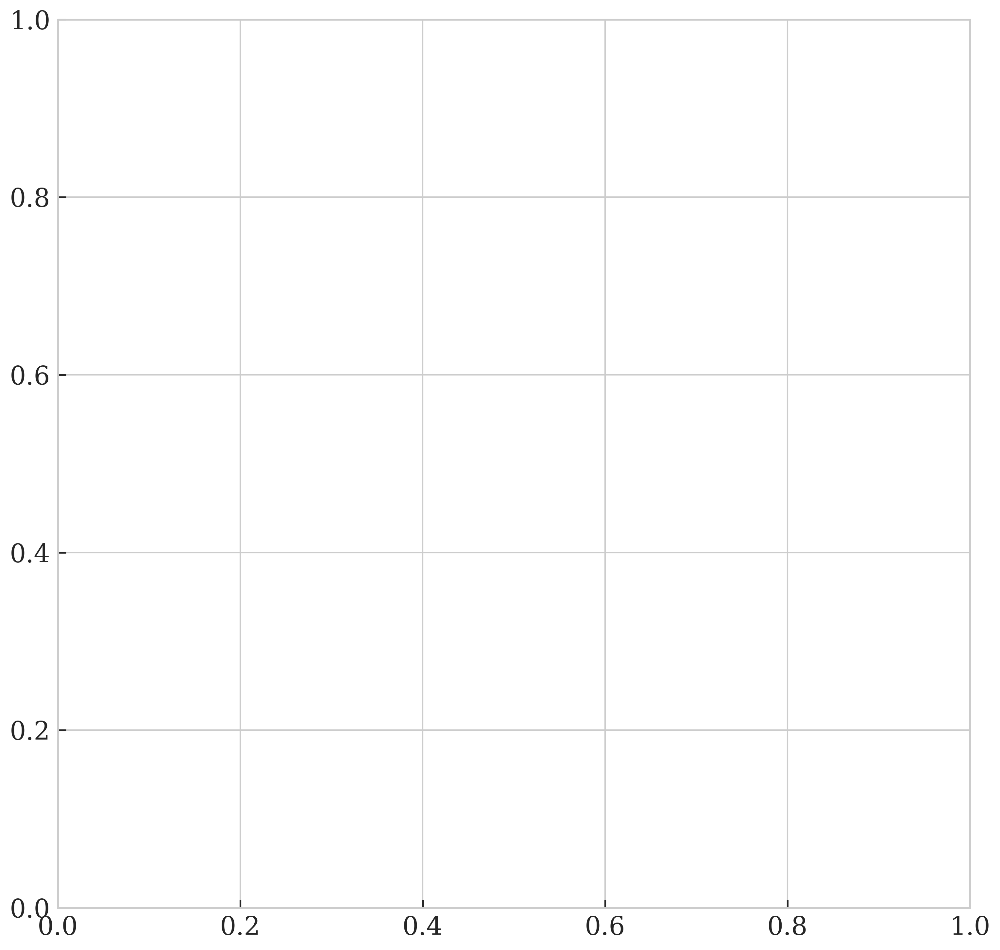

In [64]:
desi_qso_df['log_flux_05-20'] = np.log10(desi_qso_df['flux_05-20'])

# fig, ax = plt.subplots(figsize=(12, 5))
fig, ax = plt.subplots(figsize=(12, 12))

# Не квазары
not_qso_df = desi_qso_df[desi_qso_df['is_qso']==False]

# Фильтр по параллаксу и собственному движению (звезды)
star_df = lhf.star_extraction(not_qso_df, s_n_threshold=4, optic_cat='desi')

# Не звезды и не квазары
not_qso_not_star_df = not_qso_df[~not_qso_df['srcname_fin'].isin(star_df['srcname_fin'])]

# Квазары
qso_df = desi_qso_df[desi_qso_df['is_qso']==True]

# stars_logflux = np.log10(lh_desi_star_df['flux_05-20'])
# qso_logflux = np.log10(cpart_qso_sample_df['flux_05-20'])

# stars_vega = lh_desi_star_df['w1_vega_mag']
# qso_vega = cpart_qso_sample_df['W1_MAG']

ax.scatter(star_df['log_flux_05-20'], star_df['w1_vega_mag'],
           zorder=3, s=10, color='r',
           label='STARS', alpha=1)

suspicious_star_df = star_df[star_df['n_qso'] >= 1]

ax.scatter(suspicious_star_df['log_flux_05-20'], suspicious_star_df['w1_vega_mag'],
           marker='s', zorder=4, s=150, edgecolor='k', color='none',
           label=r'STARS with $\geq 1$ QSO in r_98', alpha=1)

ax.scatter(qso_df['log_flux_05-20'], qso_df['W1_MAG'], s=10,
           color='gray', label='QSO', alpha=.4, zorder=2)

suspicious_qso_df = qso_df[qso_df['n_stars'] >= 3]

ax.scatter(suspicious_qso_df['log_flux_05-20'], suspicious_qso_df['W1_MAG'],
           marker='D', zorder=4, s=100, edgecolor='royalblue', color='none',
           label=r'QSO with $\geq 3$ star in r_98', alpha=1)

# ax.scatter(not_qso_not_star_df['log_flux_05-20'],
#            not_qso_not_star_df['w1_vega_mag'],
#            marker='+', zorder=1, s=40, color='g', alpha=.4)

# log_flux_space = np.linspace(-16, -9, 10)
# ax.plot(log_flux_space, dcx.salvato_w1_line(log_flux_space), lw=2,
#         color='k', label='Salvato 17')

ax.set_ylabel('w1 vega mag')
ax.set_xlabel(r'$\log_{\rm 10}\mathrm{(F_{\rm X, 0.5 - 2})}$')

ax.set_ylim(7, 23)
ax.set_xlim(-14.7, -12.5)

lgnd = ax.legend(frameon=True)
for handle in lgnd.legendHandles:
    handle._sizes = [100]

ax.set_title(f'number of candidates {n_candidates}: (closest in r_98)')
fig.suptitle('ERO      -    DESI    -    SDSS DR16Q', fontsize=22, y=.95)

# for handle in lgnd.legendHandles:
#     handle._sizes(10)

# fig.savefig('images/EDA_plots/star_qso_separation.png', bbox_inches='tight')

plt.show()

:::

* Данные DESI + SDSS позволяют выделить три категории объектов: звезды, квазары и _остальное_
* Наложение звезд на область квазаров не получается объяснить путанницей при корреляции

# Hostless sources

In [ ]:
n_id_dupl = lh_desi_df.duplicated(subset=['srcname_fin', 'desi_id']).sum()
print(f'number of DESI sources with > 1 duplicates (by indeces): {n_id_dupl}')

coord_columns = ['RA_fin', 'DEC_fin', 'ra', 'dec']
n_radec_dupl = lh_desi_df.duplicated(subset=coord_columns).sum()
print(f'number of DESI sources with > 1 duplicates (by coordinates): {n_radec_dupl}')
print()
print('example:')

print_columns = ['srcname_fin', 'RA_fin', 'DEC_fin', 'desi_id', 'ra', 'dec', 'flux_g']
(lh_desi_df[lh_desi_df.duplicated(subset=coord_columns, keep=False)]
.sort_values('ra').head(20)[print_columns]).reset_index(drop=True)

number of DESI sources with > 1 duplicates (by indeces): 3
number of DESI sources with > 1 duplicates (by coordinates): 0

example:


,srcname_fin,RA_fin,DEC_fin,desi_id,ra,dec,flux_g


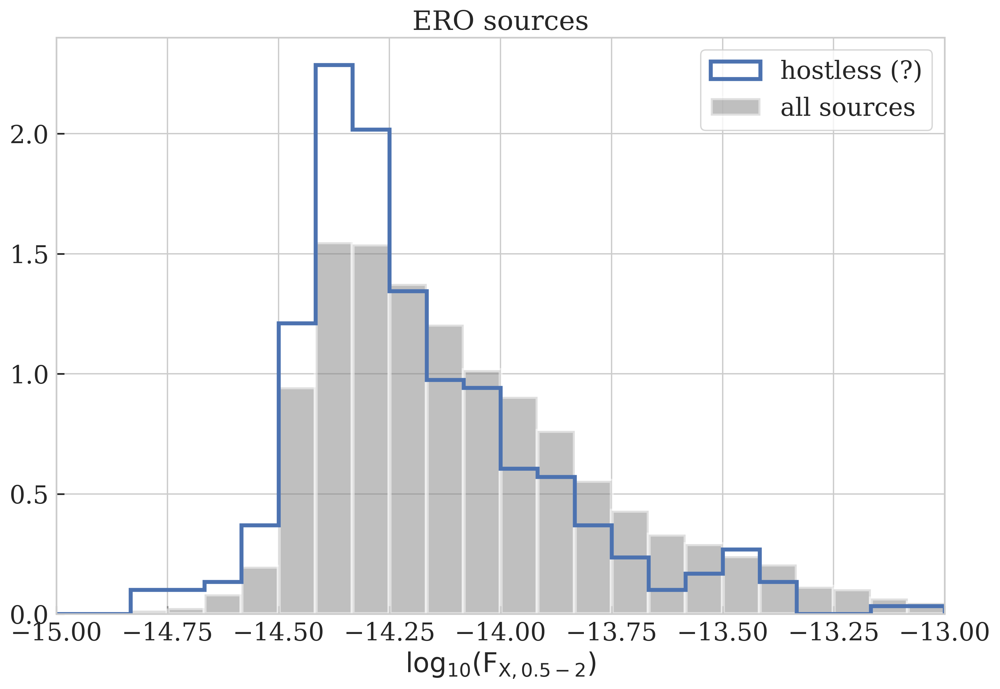

In [ ]:
fig, ax = plt.subplots(figsize=(12, 8))

hostless_df = lh_filtered_df[~lh_filtered_df['srcname_fin'].isin(desi_qso_df['srcname_fin'])]

binspase = np.linspace(-15, -13, 25)
ax.hist(np.log10(hostless_df['flux_05-20']), bins=binspase, histtype='step',
        lw=3, density=True, label='hostless (?)')
ax.hist(np.log10(lh_filtered_df['flux_05-20']), bins=binspase, color='gray',
        lw=3, density=True, alpha=.5, label='all sources')

ax.set_xlabel(r'$\log_{\rm 10}\mathrm{(F_{\rm X, 0.5 - 2})}$')

ax.set_xlim(-15, -13)

ax.legend(frameon=True)

ax.set_title('ERO sources')

plt.show()

Examples:

::: {.panel-tabset}

## Fig 1

![Fig 1](images/sdss_quick_view/1.jpeg)

## Fig 2

![Fig 2](images/sdss_quick_view/2.jpeg)

## Fig 3

![Fig 3](images/sdss_quick_view/3.jpeg)

## Fig 4

![Fig 4](images/sdss_quick_view/4.jpeg)

## Fig 5

![Fig 5](images/sdss_quick_view/5.jpeg)

:::

```
RA_fin    DEC_fin
160.050965  57.060035
161.205128  55.250382
160.064874  57.085072
159.260822  58.531078
156.488912  56.246141
157.484669  57.261345
163.362480  58.660438
158.745554  56.773860
161.197459  59.108986
160.873473  54.510635
```

In [ ]:
# # ****************************************************************************

# NSIDE = 32
# print(
#     "Approximate resolution at NSIDE {} is {:.2} deg".format(
#         NSIDE, hp.nside2resol(NSIDE, arcmin=True) / 60
#     )
# )

# NPIX = hp.nside2npix(NSIDE)

# fig, ax = plt.subplots(figsize=(15, 15))

# m = np.arange(NPIX)
# hp_map = hp.cartview(m, cmap='binary', return_projected_map=True,
#                      hold=True, cbar=False, title="ERO    -    DESI    -    SDSS DR16Q",
#                      min=0, max=1e10, lonra=[154, 167.5], latra=[53, 62])

# # hp.visufunc.projscatter(drq_df['csc_gal_l'], drq_df['csc_gal_b'], lonlat=True,
# #                         s=.1, zorder=2, color='blue', marker='o', alpha=.5)

# # hp.visufunc.projscatter(drq_df['RA'], drq_df['DEC'], lonlat=True,
# #                         s=1, zorder=2, color='blue', marker='o', alpha=.5)

# hp.visufunc.projscatter(qso_lh_df['ra'], qso_lh_df['dec'], lonlat=True,
#                         s=5, zorder=5, color='r', marker='o', alpha=1)

# hp.visufunc.projscatter(lh_df['RA_fin'], lh_df['DEC_fin'], lonlat=True,
#                         s=10, zorder=2, color='gray', marker='o', alpha=.2)

# hp.graticule(dmer=5, dpar=5)

# # fig.savefig('images/EDA_plots/sdss_dr16Q_footprint.png', bbox_inches='tight')  

In [ ]:

# ******************************************************************************

# fig, ax = plt.subplots(figsize=(14, 8))

# arcmin_area = np.pi * .5 ** 2

# counts_in_area = lh_desi_df.groupby('srcname_fin').size()
# desi_density = np.round(counts_in_area / arcmin_area, 0).astype(int)

# desi_density.value_counts().sort_index().plot(ax=ax, kind='bar')
# ax.set_title(f'DESI source density')
# ax.set_ylabel('counts')

# ax.tick_params(axis='x', labelrotation=0)
# ax.set_xlim(3, 28)
# # ax.set_yscale('log')
# ax.set_xlabel(r'$\rho,\ \rm{arcmin}^{-1}$')
# # ax.set_xlabel(r'$$')

# ******************************************************************************

# plt.show()
# fig, ax = plt.subplots(figsize=(12, 5))

# ax.hist(lh_desi_closest_df['sep'], bins=40)

# ax.set_xlabel('separation (arcsec)')
# ax.set_title('DESI closest neighbor')

# ax.set_xlim(0, 12)

# fig.savefig('images/EDA_plots/desi_closest_neighbor.png', bbox_inches='tight')

# plt.show()

# ******************************************************************************

# # Координаты ближайшего объекта в DESI для корреляции с SCSS DR16Q
# desi_lh_closest_coords = lh_desi_closest_df[['desi_id', 'ra', 'dec']]

# Table.from_pandas(desi_lh_closest_coords).write('data/correlations/desi_lh_closest_coords.fits',
#                                                 format='fits')
# ******************************************************************************

# fig, (ax, ax1) = plt.subplots(2, 1, figsize=(10, 10), sharex=True)

# # ax = axs[0, 0]; ax2 = axs[0, 1]
# # ax1 = axs[1, 0]; ax3 = axs[1, 1]

# fig.suptitle('Number of GAIA sources near ERO sources')

# lh_gaia_60_df.groupby('srcname_fin').size().value_counts().sort_index().plot(ax=ax, kind='bar')
# ax.set_title(f'in 30": total: {lh_gaia_60_df.shape[0]} ($\geq1$ GAIA for {gaia_30_frac:.0%} ERO)')
# ax.set_ylabel('counts')
# ax.set_xlim(-.5, 8)

# lh_gaia_60_df.groupby('srcname_fin').size().value_counts().sort_index().plot(ax=ax1, kind='bar', color='C7')
# ax1.set_title(f'in 60": total: {lh_gaia_60_df.shape[0]} ($\geq1$ GAIA for {gaia_60_frac:.0%} ERO)')
# ax1.set_ylabel('counts')

# ax1.set_xlabel('N')
# ax1.set_xlim(-.5, 8)

# ax1.tick_params(axis='x', labelrotation=0)

# plt.show()

***

In [ ]:
# # 100 lost stars proplem

# from astropy.coordinates import match_coordinates_3d

# # Coordinates of closest DESI sources in r_98
# cpart_coord = SkyCoord(ra=desi_qso_phot_df['ra']*u.degree, dec=desi_qso_phot_df['dec']*u.degree)
# # Coordinates of closest Gaia sources in r_98
# star_coord = SkyCoord(ra=lh_dr3_stars_df['ra']*u.degree, dec=lh_dr3_stars_df['dec']*u.degree)

# idx, closest_seps, _ = match_coordinates_3d(star_coord, cpart_coord, nthneighbor=1)

# matched_cat = cpart_coord[idx]

# # Coordinates of DESI sources from the sample defined above
# # which are closest to Gaia stars (also defined above)
# radec_data = {'desi_ra': matched_cat.ra.deg, 'desi_dec': matched_cat.dec.deg}
# matched_cat_df = pd.DataFrame(data=radec_data)

# # Coordinates of Gaia stars
# radec_data = {'gaia_ra': star_coord.ra.deg, 'gaia_dec': star_coord.dec.deg}
# star_coord_df = pd.DataFrame(data=radec_data)

# matched_df = pd.concat([matched_cat_df, star_coord_df], axis=1)

# matched_df = matched_df.merge(desi_qso_phot_df[['desi_id', 'ra']].drop_duplicates(),
#                               left_on='desi_ra', right_on='ra', how='left').drop(columns=['ra'])

# matched_df = matched_df.merge(lh_dr3_stars_df[['source_id', 'ra']].drop_duplicates(),
#                               left_on='gaia_ra', right_on='ra', how='left').drop(columns=['ra'])

# matched_df['desi_gaia_sep'] = closest_seps.arcsec

# plt.hist(matched_df['desi_gaia_sep'], bins=np.linspace(0, 2, 10))
# # plt.yscale('log')
# plt.xlim(0, 2)
# plt.show()

# For TOPCAT visualisation:

# # Pairs DESI - GAIA with suspiciously big separation
# suspicious_matched_df = matched_df[matched_df['desi_gaia_sep'] > 1]
# suspicious_matched_df.to_csv('data/star100/matched_df.csv')

# # ERO sources near these pairs
# susp_srcid_df = lh_desi_df[lh_desi_df['desi_id'].isin(suspicious_matched_df['desi_id'])]
# susp_srcid_df.to_csv('data/star100/susp_srcid_df.csv')

# # All DESI sources in r_98 aroun thesi ERO sources
# susp_desi = lh_desi_df[lh_desi_df['srcname_fin'].isin(susp_srcid_df['srcname_fin'])]
# susp_desi.to_csv('data/star100/susp_desi.csv')